<a href="https://colab.research.google.com/github/zeyalt/Famigo/blob/master/Project_ZeyaLwinTun.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Famigo: Your AI Assistant for Weekend Family Fun in Singapore

## Capstone Project Part 6

Student Name: Zeya Lwin Tun

**📘 Table of Contents**

1. 📖 Project Overview & Objectives

    - 🤖 1.1 Problem Statement
    - 🥳 1.2 Introducing Famigo
    - ⚠️ 1.3 Scope and Limitations

2. 🔎 Prerequisites

    - ⚙️ 2.1 Installs and Imports
    - 🔑 2.2 Configuration and API Key Setup

3. 🧩 Component Development

    - 🤖 3.1 Chatbot Interface
        - 🔧 3.1.1 Setting Configuration Parameters
        - 🛠️ 3.1.2 Defining Placeholder Tools and Schemas
        - 🧠 3.1.3 LLM Setup and Agent Initialization
        - 🧭 3.1.4 Controller Agent Definition
        - 💬 3.1.5 Defining and Running the Chatbot

    - ⛅ 3.2 Weather Tool
        - 🛠️ 3.2.1 Defining Function and Tool
        - ✍🏻 3.2.2 Test Cases
        - 🔌 3.2.3 Integration with Controller Agent

    - 📊 3.3 SQL Query Tool
        - 🛠️ 3.3.1 Defining Function and Tool
        - ✍🏻 3.3.2 Test Cases
        - 🔌 3.3.3 Integration with Controller Agent

    - 📄 3.4 Document QA Tool
        - 🛠️ 3.4.1 Defining Function and Tool
        - ✍🏻 3.4.2 Test Cases
        - 🔌 3.4.3 Integration with Controller Agent

    - 🖼️ 3.5 Image Generation Tool
        - 🛠️ 3.5.1 Defining Function and Tool
        - 🔉 3.5.2 Image Prompt Tuning
        - ✍🏻 3.5.3 Test Cases
        - 🔌 3.5.4 Integration with Controller Agent

4. 🔗 End-to-End System Integration

## 📖 Project Overview & Objectives

---


### 🤖 1.1 Problem Statement

In today’s fast-paced world, families often struggle to find quality time together, especially when it comes to planning meaningful and enjoyable weekend activities. Singapore, despite its small size, offers a rich variety of family-friendly attractions, events, and experiences. However, the abundance of options can make it overwhelming for parents to discover, evaluate, and select activities that best suit their family’s preferences, budget, and schedule.

The motivation behind this project stems from a desire to help families spend more quality time together. By reducing the mental load of weekend planning, we aim to support better decision-making and meaningful family experiences.





### 🥳 1.2 Introducing Famigo

**Famigo** is an AI-powered conversational assistant designed to recommend family-friendly weekend activities in Singapore. It acts as a one-stop solution that provides:

- Personalized activity suggestions based on preferences and weather
- Activity data search using natural language
- Document-based Q&A (e.g., terms and conditions, event info)
- Image generation to visualize selected activities

The system combines multiple AI capabilities into a seamless, chat-driven experience.



### ⚠️ 1.3 Scope and Limitations

While this prototype presents an integrated solution, it is designed within the following scope:

- 📍 **Geographical Scope**: Limited to within Singapore  
- 👨‍👩‍👧‍👦 **Target Audience**: Families with children  
- 🌐 **Focus**: Weekend activity recommendation

## 🔎 2. Prerequisites



---



### ⚙️ 2.1 Installs and Imports

In [1]:
pip install -Uq langchain-openai PyPDF2 geopy langchain-community pymupdf faiss-cpu

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.6/70.6 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.6/232.6 kB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 41.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.1/24.1 MB 56.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 31.3/31.3 MB 19.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.2/45.2 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.9/50.9 kB 2.7 MB/s eta 0:00:00


In [2]:
import base64
import json
import os
import requests
import sqlite3

from datetime import datetime
from io import BytesIO
from pprint import pprint
from geopy.geocoders import Nominatim
from google.colab import files, userdata
from IPython.display import Image, Markdown, display
from langchain.agents import AgentExecutor, create_openai_functions_agent
from langchain.memory import ConversationBufferWindowMemory
from langchain.text_splitter import RecursiveCharacterTextSplitter
from langchain.vectorstores import FAISS
from langchain_community.document_loaders import PyMuPDFLoader
from langchain_core.prompts import ChatPromptTemplate, MessagesPlaceholder
from langchain_core.tools import Tool
from langchain_openai import ChatOpenAI, OpenAIEmbeddings
from langchain.prompts import PromptTemplate
from langchain.chains import LLMChain
from langchain.tools import StructuredTool
from openai import OpenAI
from PIL import Image
from pydantic import BaseModel, Field
from tabulate import tabulate
from IPython.display import display, Markdown

### 🔑 2.2 Configuration and API Key Setup

For security, API keys are not hardcoded and are loaded securely via Google Colab secrets. In this section, we load the necessary API keys required for our solution.

In [3]:
OPENAI_API_KEY = userdata.get("OPENAI_API_KEY")
OPENWEATHER_API_KEY = userdata.get("OPENWEATHER_API_KEY")

## 🧩 3. Component Development



---

The goal of this section is to incrementally develop and test each building block of the chatbot to ensure they function as expected before integration. We will start off by developing the overarching conversational chatbot, keeping the respective components such as the SQL query agent and weather agent as placeholders.

### 🤖 3.1 Chatbot Interface

We will now build the core chatbot architecture, tools, and logic powering Famigo's conversational interface. The tools will be kept as placeholders for now.

#### 🛠️ 3.1.1 Setting Configuration Parameters

In [4]:
MEMORY_WINDOW_SIZE = 5
AGENT_VERBOSITY = True
TEMPERATURE_VALUE = 0
MODEL_NAME = "gpt-4-0613"
SYSTEM_PROMPT = """
You are known as 'Famigo'. You are an AI assistant who is an expert in helping families with kids in Singapore plan memorable weekend activities.
Your primary goal is to provide practical and personalized suggestions for family outings and experiences.

Your capabilities include:
1. Question-Answering from Documents:
    - Based on a PDF document uploaded by user, you are able to answer specific questions by extracting relevant details from the uploaded document. Prioritize information from these documents when available.
2. Image Generation:
    - You are capable of creating images that visually represent ideas.
    - Images can significantly help to enhanace user experience by creating a vivid illustration of the desired experience.
    - This also adds a 'wow' factor and makes your recommendation to the user more compelling.
    - If a user asks to "show me what that looks like," "generate an image of...", or describes a scene they want to visualize, you can generate an image based on their prompt.
3. Personalized Activity Recommendations:
    - You will provide tailored suggestions for weekend activities by querying from the activities database.
    - You will consider the following factors: event_start_date, event_end_date, event_price, is_kids_friendly, activity_type, indoor_or_outdoor
    - If querying the database does not yield any results based on users' preference, you will do your best to recommend from your own knowledge.
4. Weather Forecast:
    - You will adapt recommendations based on whether it will be sunny, rainy, hot, etc. (e.g., indoor activities for rain, outdoor for good weather).

When interacting with users:
- Maintain a friendly, enthusiastic, and helpful tone.
- Always focus on activities suitable for families with children.
- If information is missing (e.g., weather, preferences), politely ask the user for it to provide better recommendations.
- Strive to offer diverse options, including both well-known attractions and hidden gems in Singapore.
- Encourage multi-turn dialogue to refine recommendations.

Whenever the user's query includes vague time references in natural language, such as 'this weekend', 'next weekend', 'this Sunday' or 'next Saturday', use the 'extract_timeframe_tool' tool to extract a specific start date and end date

If a user's request is outside the scope of weekend family activities in Singapore, gently redirect them to your core purpose.
"""


#### ⚙️ 3.1.2 Defining Placeholder Tools and Schemas

Next, we will define functions and tools that we aim to integrate into our chatbot. These tools will serve as placeholders for now. We will be using LangChain framework to define these tools. We will also define the schemas to enforce the expected input format for each tool.

In [5]:
def safe_unpack_args(func, arg_key):
    def wrapper(args):
        if isinstance(args, dict):
            return func(**args)
        elif isinstance(args, str):
            return func(**{arg_key: args})
        else:
            raise ValueError("Unexpected argument type")
    return wrapper

# --- Tool #1: Weather Placeholder Tool ---
class WeatherInput(BaseModel):
    city: str

def get_weather_forecast_placeholder(city: str) -> str:
    return f"The weather in {city} is sunny and 25°C."

weather_tool_placeholder = Tool(
    name="get_weather_forecast_placeholder",
    func=safe_unpack_args(get_weather_forecast_placeholder, "city"),
    description="This is a placeholder function. Get the current weather in a given city.",
    args_schema=WeatherInput
)

# --- Tool #2: SQL Query Placeholder Tool ---
class SQLQueryInput(BaseModel):
    task: str

def generate_and_execute_sql_placeholder(question: str) -> str:
    return f"Generated SQL Query based on user's question: '{question}'"

sql_query_tool_placeholder = Tool(
    name="generate_and_execute_sql_placeholder",
    func=generate_and_execute_sql_placeholder,
    description="This is a placeholder function to simulate generating and executing a SQL query based on a natural language question to retrieve information from the activities database.",
    args_schema=SQLQueryInput
)

# --- Tool #3: Document QA Placeholder Tool (using RAG) ---
class DocumentQAInput(BaseModel):
    task: str

def run_document_qa_placeholder() -> str:
    return "The uploaded PDF document is as follows: ..."

document_qa_tool_placeholder = Tool(
    name="run_document_qa_placeholder",
    func=lambda _: run_document_qa_placeholder(),
    description="This is a placeholder function to simulate the loading of the uploaded document and answering questions on it.",
    args_schema=DocumentQAInput
)

# --- Tool #4: Image Generation Placeholder Tool ---
class ImageGenerationInput(BaseModel):
    task: str

def generate_image_placeholder(user_prompt: str) -> str:
    return f"Image generated based on user prompt '{user_prompt}': ........"

image_generation_tool_placeholder = Tool(
    name="generate_image_placeholder",
    func=safe_unpack_args(generate_image_placeholder, "user_prompt"),
    description="This is a placeholder function to simulate the generation of an image based on a user prompt",
    args_schema=ImageGenerationInput
)

#### 🧠 3.1.2 LLM Setup and Agent Initialization

Here, we will initialise the LLM with the chosen model and API key, and then combine it with the prompt and tools to create an agent.

In [6]:
def create_controller_agent(model_name, system_prompt, temperature_value, memory_window_size, tools, agent_verbosity):

    memory = ConversationBufferWindowMemory(
        k=memory_window_size,
        return_messages=True,
        output_key="output",
        memory_key="chat_history"
        )

    llm = ChatOpenAI(
        model=model_name,
        temperature=temperature_value,
        openai_api_key=OPENAI_API_KEY
        )

    prompt = ChatPromptTemplate.from_messages([
        ("system", system_prompt),
        MessagesPlaceholder(variable_name="chat_history"),
        ("user", "{input}"),
        MessagesPlaceholder(variable_name="agent_scratchpad"),
    ])

    agent = create_openai_functions_agent(
        llm=llm,
        tools=tools,
        prompt=prompt
        )

    agent_executor = AgentExecutor(
        agent=agent,
        tools=tools,
        memory=memory,
        verbose=agent_verbosity,
        return_intermediate_steps=True
    )

    return agent_executor

#### 🧭 3.1.3 Controller Agent Definition

Next, we will wrap the agent around a function to generate the response we want.  

In [7]:
def run_controller_agent(agent_executor, user_input, get_intermediate_steps):
    try:
        result = agent_executor.invoke({"input": user_input})
        response = result['output']
        if get_intermediate_steps:
            pprint(result.get('intermediate_steps'))

    except Exception as e:
        response = f"Sorry, an error occurred: {e}"

    return response

#### 💬 3.1.4 Defining and Running the Chatbot

Finally, we create a logic to demonstrate how the chatbot could potentially interact with the user.

In [8]:
def run_chatbot(agent_executor, get_intermediate_steps=False):
    display(Markdown("🎉 Hello! I'm Famigo, your AI assistant for discovering and planning family-friendly adventures on weekends in Singapore."))
    display(Markdown("Ready for adventure? I can recommend weekend activities, check the weather, and even generate images for your plans!\n"))
    display(Markdown("Type 'exit' or 'quit' to end the conversation."))
    display(Markdown("-" * 50))
    display(Markdown("\nAI: Hello! How can I help you today?"))

    while True:
        user_input = input("\nYou: ")
        if user_input.lower() in ["exit", "quit"]:
            display(Markdown("\nAI: Nice talking to you - Goodbye!"))
            break
        response = run_controller_agent(agent_executor, user_input, get_intermediate_steps)
        display(Markdown(f"\nAI: {response}"))

In [10]:
if __name__ == "__main__":

    # Define Tools
    TOOLS = [weather_tool_placeholder, sql_query_tool_placeholder, document_qa_tool_placeholder, image_generation_tool_placeholder]

    # Initialise Controller Agent
    agent_executor = create_controller_agent(
        model_name=MODEL_NAME,
        system_prompt=SYSTEM_PROMPT,
        temperature_value=TEMPERATURE_VALUE,
        memory_window_size=MEMORY_WINDOW_SIZE,
        tools=TOOLS,
        agent_verbosity=AGENT_VERBOSITY
    )

    run_chatbot(agent_executor)

🎉 Hello! I'm Famigo, your AI assistant for discovering and planning family-friendly adventures on weekends in Singapore.

Ready for adventure? I can recommend weekend activities, check the weather, and even generate images for your plans!


Type 'exit' or 'quit' to end the conversation.

--------------------------------------------------


AI: Hello! How can I help you today?


You: hello! 


> Entering new AgentExecutor chain...
Hello! How can I assist you today? Are you looking for some fun family activities to do in Singapore this weekend?

> Finished chain.



AI: Hello! How can I assist you today? Are you looking for some fun family activities to do in Singapore this weekend?


You: yes! what's the weather going to be like?


> Entering new AgentExecutor chain...

Invoking: `get_weather_forecast_placeholder` with `{'city': 'Singapore'}`


The weather in Singapore is sunny and 25°C.Great news! The weather in Singapore this weekend is going to be sunny with a pleasant temperature of 25°C. It's perfect for outdoor activities. Do you have any preferences? For example, are you interested in nature, sports, arts, or perhaps something educational for the kids?

> Finished chain.



AI: Great news! The weather in Singapore this weekend is going to be sunny with a pleasant temperature of 25°C. It's perfect for outdoor activities. Do you have any preferences? For example, are you interested in nature, sports, arts, or perhaps something educational for the kids?


You: i'm interested in something educational for my kids


> Entering new AgentExecutor chain...

Invoking: `generate_and_execute_sql_placeholder` with `{'task': 'Find educational activities for kids in Singapore this weekend'}`


Generated SQL Query based on user's question: 'Find educational activities for kids in Singapore this weekend'Here are some educational activities for your kids this weekend:

1. **Science Centre Singapore**: A world-renowned scientific institution, the Science Centre Singapore is a treasure trove of interactive exhibits, perfect for kids of all ages. They can learn about the wonders of science in a fun and engaging way.

2. **ArtScience Museum**: This museum marries art, science, culture and technology in an interactive, immersive space. Current exhibitions include Future World, where art meets science, and Into the Wild, an augmented reality experience on the importance of protecting our environment.

3. **Singapore Discovery Centre**: This 'edutainment' a


AI: Here are some educational activities for your kids this weekend:

1. **Science Centre Singapore**: A world-renowned scientific institution, the Science Centre Singapore is a treasure trove of interactive exhibits, perfect for kids of all ages. They can learn about the wonders of science in a fun and engaging way.

2. **ArtScience Museum**: This museum marries art, science, culture and technology in an interactive, immersive space. Current exhibitions include Future World, where art meets science, and Into the Wild, an augmented reality experience on the importance of protecting our environment.

3. **Singapore Discovery Centre**: This 'edutainment' attraction offers interactive exhibits and immersive shows about the history and future of Singapore. It's a great place for kids to learn about the country in a fun way.

4. **Lee Kong Chian Natural History Museum**: Home to a vast array of biodiversity and geology specimens, it's a great place for kids to learn about natural history.

5. **KidsSTOP**: An edutainment centre in the Science Centre Singapore, KidsSTOP is where children can learn about science through play and hands-on experiences.

Would you like more information on any of these options?


You: quit



AI: Nice talking to you - Goodbye!

### ⛅ 3.2 Weather Tool

In this section, we will be creating a fully functioning tool for fetching real-time weather information. We will be connecting to OpenWeatherMap via API to fetch weather forecast data, which can be subsequently used for giving users activity recommendations that takes weather into consideration.

#### 🛠️ 3.2.1 Defining Function and Tool

In [11]:
def _get_lat_lon(location_name):
    geolocator = Nominatim(user_agent="famigo")
    try:
        location = geolocator.geocode(location_name, timeout=5) # Add timeout
        if location:
            lat = round(location.latitude, 2)
            lon = round(location.longitude, 2)
            return lat, lon
        else:
            print(f"Could not find coordinates for {location_name}.")
            return None, None
    except Exception as e:
        print(f"Error getting coordinates for {location_name}: {e}")
        return None, None

def _fetch_raw_weather_data(lat, lon):
    base_url = "https://api.openweathermap.org/data/3.0/onecall"
    exclude = "minutely,hourly,alerts"
    units = "metric"
    lang = "en"

    url = f"{base_url}?lat={lat}&lon={lon}&exclude={exclude}&units={units}&lang={lang}&appid={OPENWEATHER_API_KEY}"
    try:
        response = requests.get(url, timeout=10)
        response.raise_for_status()
        return response.json()
    except requests.exceptions.RequestException as e:
        print(f"Error fetching weather data from OpenWeatherMap API: {e}")
        return None

def _parse_daily_weather_data(raw_data):
    parsed_weather_data = {}
    if raw_data and 'daily' in raw_data:
        for day_forecast in raw_data['daily']:
            dt_object = datetime.fromtimestamp(day_forecast['dt'])
            date_str = dt_object.strftime('%Y-%m-%d')
            parsed_fields = {
                'day_of_week': dt_object.strftime('%A'),
                'humidity': day_forecast.get('humidity'),
                'feels_like_morn': day_forecast.get('feels_like', {}).get('morn'),
                'feels_like_day': day_forecast.get('feels_like', {}).get('day'),
                'feels_like_night': day_forecast.get('feels_like', {}).get('night'),
                'temp_morn': day_forecast.get('temp', {}).get('morn'),
                'temp_day': day_forecast.get('temp', {}).get('day'),
                'temp_night': day_forecast.get('temp', {}).get('night'),
                'weather_description': day_forecast.get('weather', [{}])[0].get('description') if day_forecast.get('weather') else None,
                'summary': day_forecast.get('summary')
            }
            parsed_weather_data[date_str] = parsed_fields

    # Filter for weekend data only
    parsed_weather_data = [{day: parsed_weather_data.get(day)} for day in parsed_weather_data if parsed_weather_data.get(day).get('day_of_week') in ['Saturday', 'Sunday']]
    return parsed_weather_data

def get_weather_forecast(location: str) -> list[dict]:

    lat, lon = _get_lat_lon(location_name=location)
    if lat is None or lon is None:
        return []

    raw_data = _fetch_raw_weather_data(lat, lon)
    if raw_data is None:
        return []

    parsed_output = _parse_daily_weather_data(raw_data)
    return parsed_output


class WeatherInput(BaseModel):
    location: str

weather_tool = Tool(
    name="get_weather_forecast",
    func=get_weather_forecast,
    description="Get the weather forecast for upcoming weekend in a given location.",
    args_schema=WeatherInput
)

#### ✍🏻 3.2.2 Test Cases

Let's independently test the `weather_tool` on a few test cases.

In [12]:
location_list = [
    'Kuala Lumpur',
    'Mumbai',
    'Singapore',
    'Tokyo',
    'melbourne'
]

for location in location_list:
    print(f"\nWeekend Weather Forecast for {location}:")
    result = weather_tool.invoke({"location": location})
    pprint(result)


Weekend Weather Forecast for Kuala Lumpur:
[{'2025-07-19': {'day_of_week': 'Saturday',
                 'feels_like_day': 35.22,
                 'feels_like_morn': 26.44,
                 'feels_like_night': 28.55,
                 'humidity': 27,
                 'summary': 'You can expect partly cloudy in the morning, with '
                            'clearing in the afternoon',
                 'temp_day': 35.83,
                 'temp_morn': 25.91,
                 'temp_night': 27.63,
                 'weather_description': 'overcast clouds'}},
 {'2025-07-20': {'day_of_week': 'Sunday',
                 'feels_like_day': 35.47,
                 'feels_like_morn': 26.18,
                 'feels_like_night': 29.08,
                 'humidity': 34,
                 'summary': 'There will be clear sky until morning, then '
                            'partly cloudy',
                 'temp_day': 34.93,
                 'temp_morn': 25.7,
                 'temp_night': 28.04,
      

#### 🔌 3.2.3 Integration with Controller Agent

Let's now integrate this new `weather_tool` with our Controller Agent and see how it behaves.

In [13]:
if __name__ == "__main__":

    # Define Tools
    TOOLS = [weather_tool] # Integrating only the weather tool

    # Initialise Controller Agent
    agent_executor = create_controller_agent(
        model_name=MODEL_NAME,
        system_prompt=SYSTEM_PROMPT,
        temperature_value=TEMPERATURE_VALUE,
        memory_window_size=MEMORY_WINDOW_SIZE,
        tools=TOOLS,
        agent_verbosity=AGENT_VERBOSITY
    )

    run_chatbot(agent_executor)

🎉 Hello! I'm Famigo, your AI assistant for discovering and planning family-friendly adventures on weekends in Singapore.

Ready for adventure? I can recommend weekend activities, check the weather, and even generate images for your plans!


Type 'exit' or 'quit' to end the conversation.

--------------------------------------------------


AI: Hello! How can I help you today?


You: hello! can you check the weather forecast for singapore? 


> Entering new AgentExecutor chain...

Invoking: `get_weather_forecast` with `{'location': 'Singapore'}`


[{'2025-07-19': {'day_of_week': 'Saturday', 'humidity': 71, 'feels_like_morn': 30.79, 'feels_like_day': 32.76, 'feels_like_night': 30.86, 'temp_morn': 27.74, 'temp_day': 28.93, 'temp_night': 27.71, 'weather_description': 'light rain', 'summary': 'Expect a day of partly cloudy with rain'}}, {'2025-07-20': {'day_of_week': 'Sunday', 'humidity': 70, 'feels_like_morn': 30.77, 'feels_like_day': 33.39, 'feels_like_night': 30.86, 'temp_morn': 27.67, 'temp_day': 29.3, 'temp_night': 27.77, 'weather_description': 'light rain', 'summary': 'You can expect rain in the morning, with partly cloudy in the afternoon'}}]Hello! Here's the weather forecast for Singapore:

- On Saturday, 19th July 2025, it will be partly cloudy with light rain. The morning temperature will be around 27.74°C, feeling like 30.79°C. During the day, the temp


AI: Hello! Here's the weather forecast for Singapore:

- On Saturday, 19th July 2025, it will be partly cloudy with light rain. The morning temperature will be around 27.74°C, feeling like 30.79°C. During the day, the temperature will rise to 28.93°C, feeling like 32.76°C, and at night it will be around 27.71°C, feeling like 30.86°C. The humidity will be around 71%.

- On Sunday, 20th July 2025, there will be light rain in the morning, turning partly cloudy in the afternoon. The morning temperature will be around 27.67°C, feeling like 30.77°C. During the day, the temperature will rise to 29.3°C, feeling like 33.39°C, and at night it will be around 27.77°C, feeling like 30.86°C. The humidity will be around 70%.

Given the weather, it might be a good idea to plan some indoor activities. Would you like some recommendations for family-friendly indoor activities for this weekend?


You: oh, i might be going to Kuala Lumpur too. will the weather there be ok?


> Entering new AgentExecutor chain...

Invoking: `get_weather_forecast` with `{'location': 'Kuala Lumpur'}`


[{'2025-07-19': {'day_of_week': 'Saturday', 'humidity': 27, 'feels_like_morn': 26.44, 'feels_like_day': 35.22, 'feels_like_night': 28.55, 'temp_morn': 25.91, 'temp_day': 35.83, 'temp_night': 27.63, 'weather_description': 'overcast clouds', 'summary': 'You can expect partly cloudy in the morning, with clearing in the afternoon'}}, {'2025-07-20': {'day_of_week': 'Sunday', 'humidity': 34, 'feels_like_morn': 26.18, 'feels_like_day': 35.47, 'feels_like_night': 29.08, 'temp_morn': 25.7, 'temp_day': 34.93, 'temp_night': 28.04, 'weather_description': 'overcast clouds', 'summary': 'There will be clear sky until morning, then partly cloudy'}}]Sure, here's the weather forecast for Kuala Lumpur:

- On Saturday, 19th July 2025, it will be partly cloudy in the morning, with clearing in the afternoon. The morning 


AI: Sure, here's the weather forecast for Kuala Lumpur:

- On Saturday, 19th July 2025, it will be partly cloudy in the morning, with clearing in the afternoon. The morning temperature will be around 25.91°C, feeling like 26.44°C. During the day, the temperature will rise to 35.83°C, feeling like 35.22°C, and at night it will be around 27.63°C, feeling like 28.55°C. The humidity will be around 27%.

- On Sunday, 20th July 2025, there will be clear sky until morning, then partly cloudy. The morning temperature will be around 25.7°C, feeling like 26.18°C. During the day, the temperature will rise to 34.93°C, feeling like 35.47°C, and at night it will be around 28.04°C, feeling like 29.08°C. The humidity will be around 34%.

The weather seems to be quite warm, so it might be a good idea to plan some indoor activities or activities that allow you to stay cool. Would you like some recommendations for family-friendly activities in Kuala Lumpur for this weekend?


You: quit



AI: Nice talking to you - Goodbye!

### 📊 3.3 SQL Query Tool

In this section, we will create a SQL query tool to translate a user's question to a SQL query, and then execute the generated query to return a human-readable, natural language response that addresses the question.

The workflow consists of the following steps:
1. Create the database containing data on weekend activities in Singapore.
2. Agent interprets user's question and database schema and generates a SQL query to answer the question.
3. Agent validates the generated SQL query before executing it.
4. Agent summarises and presents the resulting information in a helpful, natural and coherent manner.


#### 🛠️ 3.3.1 Defining Function and Tool

In [14]:
def setup_database():
    try:
        conn = sqlite3.connect("weekend_activities.db")
        c = conn.cursor()

        # Create activities
        try:
            c.execute('''
                CREATE TABLE IF NOT EXISTS activities (
                    activity TEXT,
                    start_date TEXT,
                    end_date TEXT,
                    start_time TEXT,
                    end_time TEXT,
                    location TEXT,
                    country TEXT,
                    price INTEGER,
                    indoor_outdoor TEXT,
                    kid_friendly TEXT,
                    activity_type TEXT
                )
            ''')
        except sqlite3.Error as e:
            print(f"❌ Error creating tables: {e}")
            conn.rollback()
            raise

        # Insert data
        try:
            activities = [
                ("Harmony Fest! ‘25", '2025-07-05', '2025-07-06', '10:00', '20:00', "100PLUS Promenade & OCBC Square", 'singapore', 0, 'outdoor', 'yes', 'festival'),
                ("Sentosa Sensoryscape: Peranakan Reimagined", '2025-05-23', '2025-08-31', '07:30', '21:30', "Sentosa Sensoryscape", 'singapore', 0, 'outdoor', 'yes', 'park'),
                ("Skechers Sundown Festival 2025", '2025-07-04', '2025-07-06', '16:00', '22:30', "Haw Par Villa", 'singapore', 25, 'outdoor', 'no', 'performance'),
                ("BBC Earth Screening Festival (Walking With Dinosaurs)", '2025-07-04', '2025-07-06', '18:00', '21:00', "Gardens by the Bay", 'singapore', 0, 'outdoor', 'yes', 'cinema'),
                ("The Sunday Social (Peranakan theme market)", '2025-07-04', '2025-07-06', '11:00', '18:00', "Sentosa", 'singapore', 0, 'outdoor', 'yes', 'market'),
                ("Mummys Market Baby Fair", '2025-07-04', '2025-07-06', '10:00', '20:00', "Singapore EXPO", 'singapore', 8, 'indoor', 'yes', 'market'),
                ("Science Centre’s Omni-Theatre", '2025-07-05', '2025-07-06', '10:00', '18:00', "Science Centre Singapore", 'singapore', 13, 'indoor', 'yes', 'science'),
                ("Balloon Museum: Pop Air", '2025-07-05', '2025-08-31', '10:00', '21:00', "MBS (ArtScience)", 'singapore', 20, 'indoor', 'yes', 'exhibition'),
                ("Van Gogh Inside: Love Vincent", '2025-07-05', '2025-08-31', '10:00', '21:00', "Parkview Square", 'singapore', 25, 'indoor', 'yes', 'museum'),
                ("Dino Discovery Maze", '2025-07-12', '2025-07-13', '09:00', '18:00', "Jurong Bird Park", 'singapore', 12, 'outdoor', 'yes', 'interactive'),
                ("Mini Makers Fair", '2025-07-13', '2025-07-14', '10:00', '17:00', "Suntec Convention Hall", 'singapore', 5, 'indoor', 'yes', 'education'),
                ("Underwater World Experience", '2025-07-18', '2025-07-20', '10:00', '19:00', "S.E.A. Aquarium", 'singapore', 20, 'indoor', 'yes', 'exhibition'),
                ("Garden Explorers Tour", '2025-07-19', '2025-07-21', '08:30', '11:30', "Singapore Botanic Gardens", 'singapore', 0, 'outdoor', 'yes', 'park'),
                ("Family Outdoor Yoga", '2025-07-19', '2025-07-20', '07:00', '09:00', "East Coast Park", 'singapore', 0, 'outdoor', 'yes', 'park'),
                ("LEGO City Builder Challenge", '2025-07-20', '2025-07-21', '10:00', '18:00', "Marina Square Atrium", 'singapore', 15, 'indoor', 'yes', 'interactive'),
                ("Children’s Theatre: The Magic Pond", '2025-07-20', '2025-07-22', '14:00', '15:30', "Esplanade Theatre Studio", 'singapore', 18, 'indoor', 'yes', 'performance'),
                ("Robotics Discovery Workshop", '2025-07-26', '2025-07-28', '10:00', '17:00', "Science Centre Singapore", 'singapore', 10, 'indoor', 'yes', 'education'),
                ("Family Film Night: Pixar Classics", '2025-07-26', '2025-07-26', '19:00', '21:00', "The Star Vista Outdoor Lawn", 'singapore', 0, 'outdoor', 'yes', 'cinema')
            ]

            for a in activities:
                c.execute("INSERT OR IGNORE INTO activities VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)", a)

            conn.commit()

        except sqlite3.Error as e:
            print(f"❌ Error inserting data: {e}")
            conn.rollback()
            raise

        finally:
            conn.close()

    except sqlite3.Error as e:
        print(f"❌ Database error: {e}")
        raise
    except Exception as e:
        print(f"❌ Unexpected error: {e}")
        raise

def get_schema():
    return """
    Table Name: activities
    Columns:
    - activity (TEXT)
    - start_date (TEXT)
    - end_date (TEXT)
    - start_time (TEXT)
    - end_time (TEXT)
    - location (TEXT)
    - country (TEXT)
    - price (INTEGER)
    - indoor_outdoor (TEXT)
    - kid_friendly (TEXT)
    - activity_type (TEXT)
    """


class TimeframeExtractionInput(BaseModel):
    user_query: str = Field(description="User's natural language query containing time-related expressions")

def extract_timeframe(user_query: str):

    timeframe_prompt = PromptTemplate.from_template("""
    You are a helpful assistant that extracts specific dates from natural language.

    Today's date is {today}.

    User query: "{user_query}"

    Extract the relevant date or date range mentioned. Return your answer as JSON with either:
    - one day: {{ "start_date": "YYYY-MM-DD", "end_date": "YYYY-MM-DD" }}

    If no date is mentioned, return {{ "start_date": null, "end_date": null }}.
    """)

    llm=ChatOpenAI(model=MODEL_NAME, temperature=TEMPERATURE_VALUE, openai_api_key=OPENAI_API_KEY)
    chain = LLMChain(
        llm=llm,
        prompt=timeframe_prompt
    )

    today = datetime.today().strftime("%Y-%m-%d")
    response = chain.run(user_query=user_query, today=today)

    try:
        date_info = json.loads(response)
        return {
            "start_date": date_info.get("start_date"),
            "end_date": date_info.get("end_date")
        }

    except Exception as e:
        print("Failed to parse date JSON:", response)
        return {"start_date": None, "end_date": None}

extract_timeframe_tool = Tool(
    name="extract_timeframe_tool",
    func=lambda query: extract_timeframe(query),
    description="Use this tool to extract a specific start date and end date when the user's query includes vague time references in natural language, such as 'this weekend', 'next weekend', 'this Sunday' or 'next Saturday'.",
    args_schema=TimeframeExtractionInput
)

# Define the input schema for your SQL generation tool
class SQLQueryInput(BaseModel):
    question: str = Field(description="The natural language question to convert into a SQL query.")

def generate_and_execute_sql_langchain(question: str) -> list[tuple]:
    """
    Generates a SQL query from a natural language question and executes it against the SQLite database.
    Returns the raw query results.
    """

    # global llm # If llm is defined outside this function and you want to use it directly
    llm=ChatOpenAI(model=MODEL_NAME, temperature=TEMPERATURE_VALUE, openai_api_key=OPENAI_API_KEY)

    # 1. Generate SQL Query using LLM
    prompt = ChatPromptTemplate.from_messages([
        ("system", f"""You are a SQL expert. You must generate a SQLite SQL query based on the user's question and the provided schema.
        Adhere strictly to the schema provided. Do not use columns not in the schema.
        Return ONLY the SQL query without any explanation, markdown formatting, or surrounding text.
        If the weather forecast indicates that it may be raining, then filter for 'indoor_outdoor' as 'indoor'.
        Use the 'extract_timeframe_tool' if the user's query mentions vague references of time such as 'this weekend', 'next Sunday', 'this Saturday' etc.

        Schema:
        {get_schema()}
        """),
        ("user", "Generate SQL for: {question}")
    ])

    sql_generation_chain = prompt | llm

    try:
        sql_response_message = sql_generation_chain.invoke({"question": question})
        generated_sql = sql_response_message.content.strip()

        # Post-processing: Remove markdown code block syntax
        generated_sql = generated_sql.replace('```sql', '').replace('```SQL', '').replace('```', '')
        generated_sql = ' '.join(generated_sql.split('\n')).strip() # Collapse multiline queries
        generated_sql = generated_sql.lower() # Convert to lower case

        print(f"Generated SQL: {generated_sql}")

    except Exception as e:
        return [(f"Error generating SQL: {e}",)]

    # 2. Execute the generated SQL Query
    conn = None # Initialize conn to None
    try:
        conn = sqlite3.connect('weekend_activities.db')
        c = conn.cursor()

        # Basic SQL Validation - Check for Dangerous SQL Keywords
        if any(word in generated_sql for word in ['drop', 'delete', 'update', 'insert', 'alter', 'create']):
            raise ValueError(f"Only SELECT queries are allowed.")

        # Basic SQL Validation - Ensure SQL Query Starts with SELECT
        if not generated_sql.startswith("select"):
            raise ValueError(f"Query must start with SELECT statement.")

        c.execute(generated_sql)
        results = c.fetchall()
        return results

    except sqlite3.Error as e:
        return [(f"Database query error: {e}",)]

    except Exception as e:
        return [(f"An unexpected error occurred during SQL execution: {e}",)]

    finally:
        if conn: # Ensure conn exists before closing
            conn.close()

sql_query_tool = Tool(
    name="generate_and_execute_sql_langchain",
    func=generate_and_execute_sql_langchain,
    description="Generates and executes a SQL query based on a natural language question to retrieve information from the activities database, which contains information such as event name, event start and end dates, location/venue, price, indoor or outdoor, or whether it is kids friendly. Returns raw query results (list of tuples).",
    args_schema=SQLQueryInput
)


#### ✍🏻 3.3.2 Test Cases

Let's test the `extract_timeframe_tool`.

In [16]:
user_query_list = [
    "What free outdoor events are happening this weekend?",
    "Can you suggest indoor kid-friendly activities with a budget of $10 next Saturday?",
    "Any museum exhibitions running from 17th to 21st July 2025?",
    "Looking for educational or science events for kids for two weekends from now.",
]

for user_query in user_query_list:
    print(f"\nUser Query: {user_query}")
    print(extract_timeframe_tool.run({"user_query": user_query}))


User Query: What free outdoor events are happening this weekend?
{'start_date': '2025-07-19', 'end_date': '2025-07-20'}

User Query: Can you suggest indoor kid-friendly activities with a budget of $10 next Saturday?
{'start_date': '2025-07-22', 'end_date': '2025-07-22'}

User Query: Any museum exhibitions running from 17th to 21st July 2025?
{'start_date': '2025-07-17', 'end_date': '2025-07-21'}

User Query: Looking for educational or science events for kids for two weekends from now.
{'start_date': '2025-07-25', 'end_date': '2025-07-27'}


Now, we test the `sql_query_tool`.

In [17]:
# Run this once only
if not os.path.exists('weekend_activities.db'):
    setup_database()
else:
    print("Database already exists. Skipping setup.")

In [18]:
user_query_list = [
    "What free outdoor events are happening?",
    "Can you suggest indoor kid-friendly activities with a budget of $10?",
    "Any museum exhibitions running from 17th to 21st July 2025?",
    "Looking for educational or science events for kids.",
]

columns = [
    "Activity", "Start Date", "End Date", "Start Time", "End Time",
    "Location", "Country", "Price", "Indoor/Outdoor", "Kid Friendly", "Activity Type"
]

for user_query in user_query_list:
    print(f"\nUser Query: {user_query}")
    result = sql_query_tool.run({"question": user_query})
    print(tabulate(result, headers=columns, tablefmt="grid"))


User Query: What free outdoor events are happening?
Generated SQL: select * from activities where price = 0 and indoor_outdoor = 'outdoor';
+-------------------------------------------------------+--------------+------------+--------------+------------+---------------------------------+-----------+---------+------------------+----------------+-----------------+
| Activity                                              | Start Date   | End Date   | Start Time   | End Time   | Location                        | Country   |   Price | Indoor/Outdoor   | Kid Friendly   | Activity Type   |
+=======================================================+==============+============+==============+============+=================================+===========+=========+==================+================+=================+
| Harmony Fest! ‘25                                     | 2025-07-05   | 2025-07-06 | 10:00        | 20:00      | 100PLUS Promenade & OCBC Square | singapore |       0 | outdoor          

#### 🔌 3.3.3 Integration with Controller Agent

Let's integrate this new `sql_query_tool` with our Controller Agent.

In [20]:
if __name__ == "__main__":

    # Define Tools
    TOOLS = [extract_timeframe_tool, sql_query_tool] # Integrating only the timeframe extraction and SQL query tool

    # Initialise Controller Agent
    agent_executor = create_controller_agent(
        model_name=MODEL_NAME,
        system_prompt=SYSTEM_PROMPT,
        temperature_value=TEMPERATURE_VALUE,
        memory_window_size=MEMORY_WINDOW_SIZE,
        tools=TOOLS,
        agent_verbosity=AGENT_VERBOSITY
    )

    run_chatbot(agent_executor)

🎉 Hello! I'm Famigo, your AI assistant for discovering and planning family-friendly adventures on weekends in Singapore.

Ready for adventure? I can recommend weekend activities, check the weather, and even generate images for your plans!


Type 'exit' or 'quit' to end the conversation.

--------------------------------------------------


AI: Hello! How can I help you today?


You: hello, i'm Zeya!


> Entering new AgentExecutor chain...
Hello Zeya! It's great to meet you. How can I assist you in planning a memorable weekend activity for your family in Singapore?

> Finished chain.



AI: Hello Zeya! It's great to meet you. How can I assist you in planning a memorable weekend activity for your family in Singapore?


You: yes, can you suggest something that indoor - either museum or exhibition will be good. oh, my budget is $30.


> Entering new AgentExecutor chain...

Invoking: `generate_and_execute_sql_langchain` with `{'question': 'What are some indoor museums or exhibitions in Singapore that cost less than $30 and are kid-friendly?'}`


Generated SQL: select * from activities where country = 'singapore' and price < 30 and kid_friendly = 'yes' and indoor_outdoor = 'indoor' and (activity_type = 'museum' or activity_type = 'exhibition');
[('Balloon Museum: Pop Air', '2025-07-05', '2025-08-31', '10:00', '21:00', 'MBS (ArtScience)', 'singapore', 20, 'indoor', 'yes', 'exhibition'), ('Van Gogh Inside: Love Vincent', '2025-07-05', '2025-08-31', '10:00', '21:00', 'Parkview Square', 'singapore', 25, 'indoor', 'yes', 'museum'), ('Underwater World Experience', '2025-07-18', '2025-07-20', '10:00', '19:00', 'S.E.A. Aquarium', 'singapore', 20, 'indoor', 'yes', 'exhibition')]Sure, Zeya! Here are some indoor a


AI: Sure, Zeya! Here are some indoor activities that you might be interested in:

1. **Balloon Museum: Pop Air**
   - Venue: MBS (ArtScience)
   - Date: 5th July 2025 - 31st August 2025
   - Time: 10:00 - 21:00
   - Price: $20
   - Type: Exhibition

2. **Van Gogh Inside: Love Vincent**
   - Venue: Parkview Square
   - Date: 5th July 2025 - 31st August 2025
   - Time: 10:00 - 21:00
   - Price: $25
   - Type: Museum

3. **Underwater World Experience**
   - Venue: S.E.A. Aquarium
   - Date: 18th July 2025 - 20th July 2025
   - Time: 10:00 - 19:00
   - Price: $20
   - Type: Exhibition

These activities are all kid-friendly and within your budget. Let me know if you need more information about any of these options!


You: quit



AI: Nice talking to you - Goodbye!

### 📄 3.4 Document QA Tool

In this section, we will create a Document Question-and-Answering (QA) tool to answer user's questions based on an uploaded document. To do so, we will implement Retrievel-Augmented Generation with FAISS vector database, together with 'text-embedding-ada-002' text embeddings to retrieve the relevant information.


#### 🛠️ 3.4.1 Defining Function and Tool

In [21]:
class DocumentQAInput(BaseModel):
    user_query: str = Field(description="The natural language question that the user is asking about an uploaded PDF document.")
    pdf_filepath: str = Field(description="The full filepath provided by the user of the PDF document he/she intends to ask about.")

def run_document_qa(user_query, pdf_filepath) -> str:

    # Load the PDF file
    pdf_filename = pdf_filepath
    loader = PyMuPDFLoader(pdf_filename)
    documents = loader.load()
    # print(f"Loaded {len(documents)} documents")

    # Initialize the text splitter
    splitter = RecursiveCharacterTextSplitter(
        chunk_size=200,
        chunk_overlap=40,
        separators=["\n\n", "\n", ".", " ", ""]
    )

    # Split the documents
    chunks = splitter.split_documents(documents)

    # Instantiate an embedding model
    embedding_model = OpenAIEmbeddings(openai_api_key=OPENAI_API_KEY)  # uses text-embedding-ada-002 by default

    # Create FAISS index
    vectorstore = FAISS.from_documents(chunks, embedding_model)

    # Search the most relevant chunks
    results = vectorstore.similarity_search(user_query, k=5)

    context = "\n".join([doc.page_content for doc in results])

    # Prompt the LLM to generate an answer
    prompt_template = PromptTemplate(
        input_variables=["context", "question"],
        template="""
        You are a helpful assistant answering questions based on the provided context from a PDF.

        Context:
        {context}

        Question:
        {question}

        Answer in a clear and concise manner:
        """
    )

    llm = ChatOpenAI(temperature=0.7, openai_api_key=OPENAI_API_KEY, model=MODEL_NAME)

    chain = LLMChain(llm=llm, prompt=prompt_template)
    answer = chain.run({"context": context, "question": user_query})

    return answer

document_qa_tool = StructuredTool(
    name="document_qa_tool",
    func=run_document_qa,
    description="Extract contextually relevant information from the uploaded PDF document and give a clear answer to user's query",
    args_schema=DocumentQAInput
)

#### ✍🏻 3.4.2 Test Cases

Now, we will test the `document_qa_tool` independently. We will simulate the user uploading a PDF document by specifying a filepath for the document. The PDF document that we will use contains the Terms & Conditions for people visiting the attractions in Resort World Sentosa in Singapore - either Adventure Cove Waterpark or Universal Studios Singapore.

In [22]:
query_list = [
    "can i bring in outside food?",
    "do you provide baby strollers?",
    "can my season pass be shared with another person?"
    ]

for query in query_list:
    answer = document_qa_tool.run({"user_query": query, "pdf_filepath": "/content/Resort World Sentosa Terms & Conditions.pdf"})
    print(f"\nUser Query: {query}")
    print(f"Answer: {answer}")


User Query: can i bring in outside food?
Answer: No, outside food and beverages are not permitted.

User Query: do you provide baby strollers?
Answer: Yes, baby strollers are provided for rent at Universal Studios Singapore.

User Query: can my season pass be shared with another person?
Answer: No, your season pass cannot be shared with another person. It requires personal information and a recent photo, indicating that it is intended for individual use only.


#### 🔌 3.4.3 Integration with Controller Agent

In [23]:
if __name__ == "__main__":

    # Define Tools
    TOOLS = [document_qa_tool] # Integrating only the Document QA tool

    # Initialise Controller Agent
    agent_executor = create_controller_agent(
        model_name=MODEL_NAME,
        system_prompt=SYSTEM_PROMPT,
        temperature_value=TEMPERATURE_VALUE,
        memory_window_size=MEMORY_WINDOW_SIZE,
        tools=TOOLS,
        agent_verbosity=AGENT_VERBOSITY
    )

    run_chatbot(agent_executor)

🎉 Hello! I'm Famigo, your AI assistant for discovering and planning family-friendly adventures on weekends in Singapore.

Ready for adventure? I can recommend weekend activities, check the weather, and even generate images for your plans!


Type 'exit' or 'quit' to end the conversation.

--------------------------------------------------


AI: Hello! How can I help you today?


You: hi! can you answer some questions from a PDF document i upload?


> Entering new AgentExecutor chain...
Of course! I'd be happy to help. Please upload the PDF document and let me know what questions you have.

> Finished chain.



AI: Of course! I'd be happy to help. Please upload the PDF document and let me know what questions you have.


You: the document is at this path: "/content/Resort World Sentosa Terms & Conditions.pdf". can i bring outside food into USS?


> Entering new AgentExecutor chain...

Invoking: `document_qa_tool` with `{'user_query': 'can i bring outside food into USS?', 'pdf_filepath': '/content/Resort World Sentosa Terms & Conditions.pdf'}`


No, you cannot bring outside food or beverages into Universal Studios Singapore (USS).According to the Terms & Conditions of Resort World Sentosa, outside food or beverages are not allowed into Universal Studios Singapore (USS). I hope this information helps! If you have any other questions, feel free to ask.

> Finished chain.



AI: According to the Terms & Conditions of Resort World Sentosa, outside food or beverages are not allowed into Universal Studios Singapore (USS). I hope this information helps! If you have any other questions, feel free to ask.


You: ok, i'm thinking of packing lunch for my kids. am i allowed to bring outside food in?


> Entering new AgentExecutor chain...

Invoking: `document_qa_tool` with `{'user_query': 'Can I bring outside food for my kids into Universal Studios Singapore?', 'pdf_filepath': '/content/Resort World Sentosa Terms & Conditions.pdf'}`


The provided context does not include information about bringing outside food into Universal Studios Singapore.I'm sorry, but the document you provided doesn't specify whether outside food for kids is allowed in Universal Studios Singapore. However, most theme parks have strict policies against outside food and beverages. I would recommend contacting Universal Studios Singapore directly to get the most accurate information. Is there anything else you would like to know?

> Finished chain.



AI: I'm sorry, but the document you provided doesn't specify whether outside food for kids is allowed in Universal Studios Singapore. However, most theme parks have strict policies against outside food and beverages. I would recommend contacting Universal Studios Singapore directly to get the most accurate information. Is there anything else you would like to know?


You: got it. can i share my season pass with my sister?


> Entering new AgentExecutor chain...

Invoking: `document_qa_tool` with `{'user_query': 'can i share my season pass with my sister?', 'pdf_filepath': '/content/Resort World Sentosa Terms & Conditions.pdf'}`


No, you cannot share your season pass with your sister. The pass is tied to your personal information and requires a photo of you. It must be presented at all times for admission and to enjoy the season pass's benefits and discounts.According to the Terms & Conditions of Resort World Sentosa, you cannot share your season pass with your sister. The pass is tied to your personal information and requires a photo of you. It must be presented at all times for admission and to enjoy the season pass's benefits and discounts. If you have any other questions, feel free to ask!

> Finished chain.



AI: According to the Terms & Conditions of Resort World Sentosa, you cannot share your season pass with your sister. The pass is tied to your personal information and requires a photo of you. It must be presented at all times for admission and to enjoy the season pass's benefits and discounts. If you have any other questions, feel free to ask!


You: quit



AI: Nice talking to you - Goodbye!

### 🖼️ 3.5 Image Generation Tool

In this section, we will develop a tool for generating images from a user prompt. We will be using OpenAI's DALL-E image generation model

#### 🛠️ 3.5.1 Defining Function and Tool

In [24]:
class ImageGenerationInput(BaseModel):
    prompt: str = Field(description="The detailed text description for the image to be generated.")

def generate_dalle_image(prompt: str) -> str:

    client = OpenAI(api_key=OPENAI_API_KEY)

    try:

        generation_response = client.images.generate(
            model="dall-e-3",
            prompt=prompt,
            n=1,
            size="1024x1024",
            response_format="b64_json",
        )

        image_b64 = generation_response.data[0].b64_json
        generated_image_bytes = base64.b64decode(image_b64)

        img = Image.open(BytesIO(generated_image_bytes))
        display(img)
        return f"Image generated and displayed successfully using the following prompt:\n\n{prompt}"

    except Exception as e:
        return f"Sorry, there was an error generating an image: {e}"


dalle_image_tool = Tool(
    name="dalle_image_tool",
    func=generate_dalle_image,
    description="Generates an image based on an input text prompt. Use the `refine_image_prompt_tool` first to generate a more detailed prompt, and then use that detailed prompt to generate an image. Do this whenever the user asks to visualize something, generate an image, or show what something looks like.",
    args_schema=ImageGenerationInput
)

Writing a good prompt is key to generating high-quality images. We will experiment with prompt tuning by incrementally varying the level of details in the prompt, and visualise how the generated images evolve.

#### 🔉 3.5.2 Image Prompt Tuning

**Iteration 1: Start with Basic Prompt**

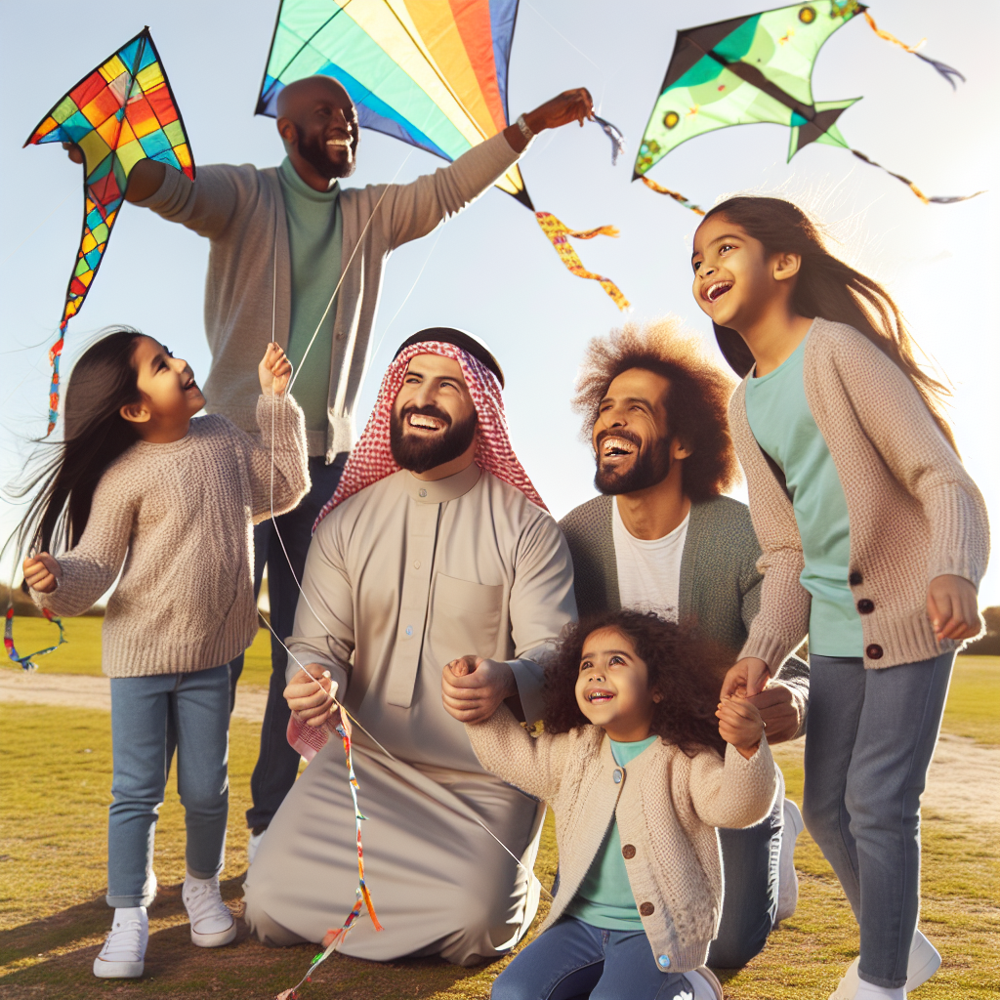

'Image generated and displayed successfully using the following prompt:\n\nFamily with children flying kites'

In [25]:
image_prompt1 = "Family with children flying kites"
dalle_image_tool.run({"prompt": image_prompt1})

**Iteration 2: Add Context**

Now, we will add some information about the subjects as well as location to the prompt to make it more relevant to the Singapore context.

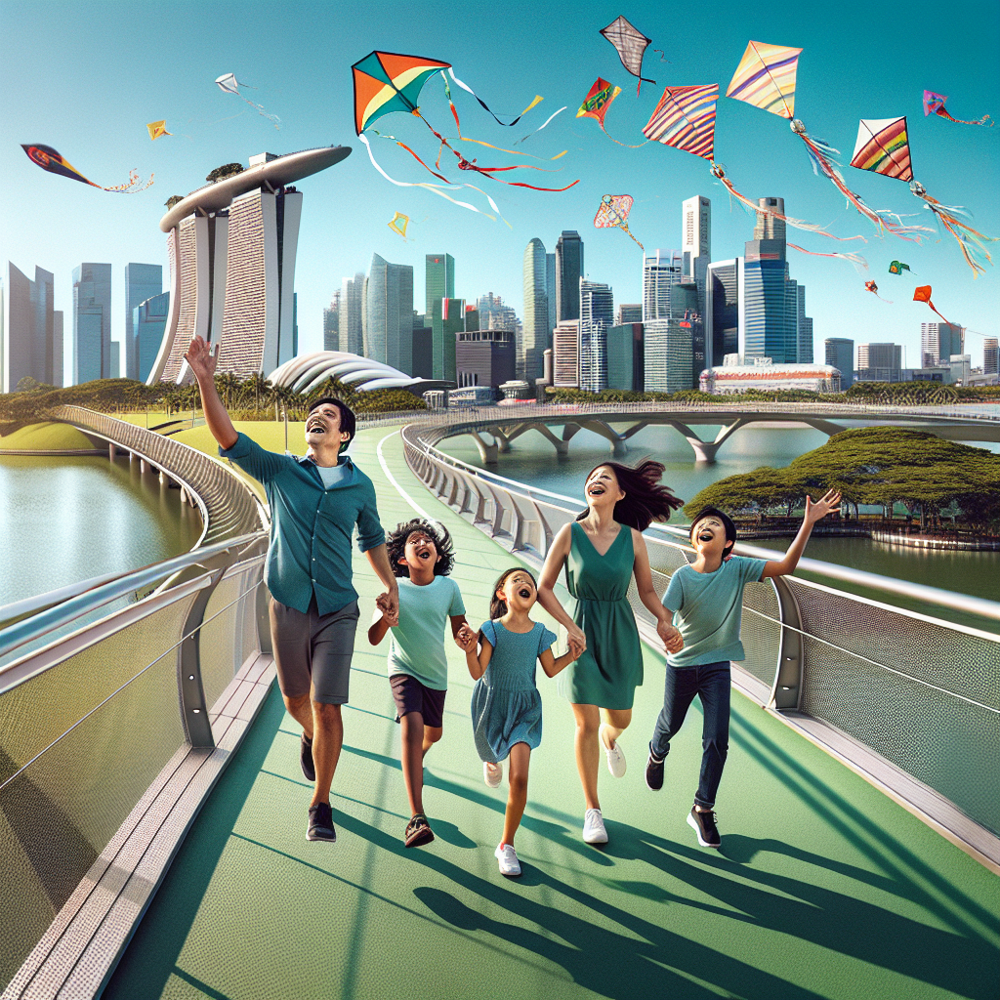

'Image generated and displayed successfully using the following prompt:\n\nA family with three young children flying kites at Marina Barrage in Singapore.'

In [26]:
image_prompt2 = "A family with three young children flying kites at Marina Barrage in Singapore."
dalle_image_tool.run({"prompt": image_prompt2})

**Iteration 3: Add Scene Composition**

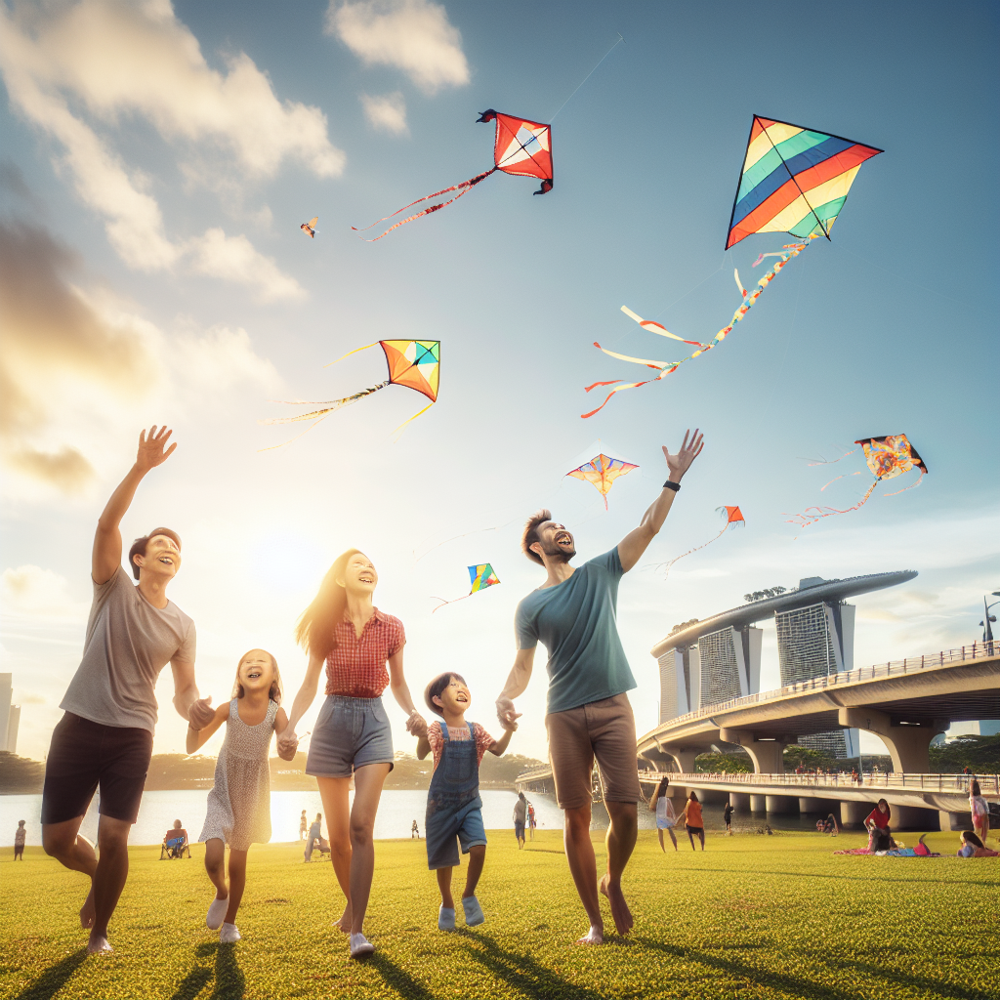

'Image generated and displayed successfully using the following prompt:\n\nA family with three young children flying kites at Marina Barrage in Singapore on a sunny weekend morning on a big open field with lushy grass.'

In [27]:
image_prompt3 = "A family with three young children flying kites at Marina Barrage in Singapore on a sunny weekend morning on a big open field with lushy grass."
dalle_image_tool.run({"prompt": image_prompt3})

**Iteration 4: Add Mood, Lighting and Colour**

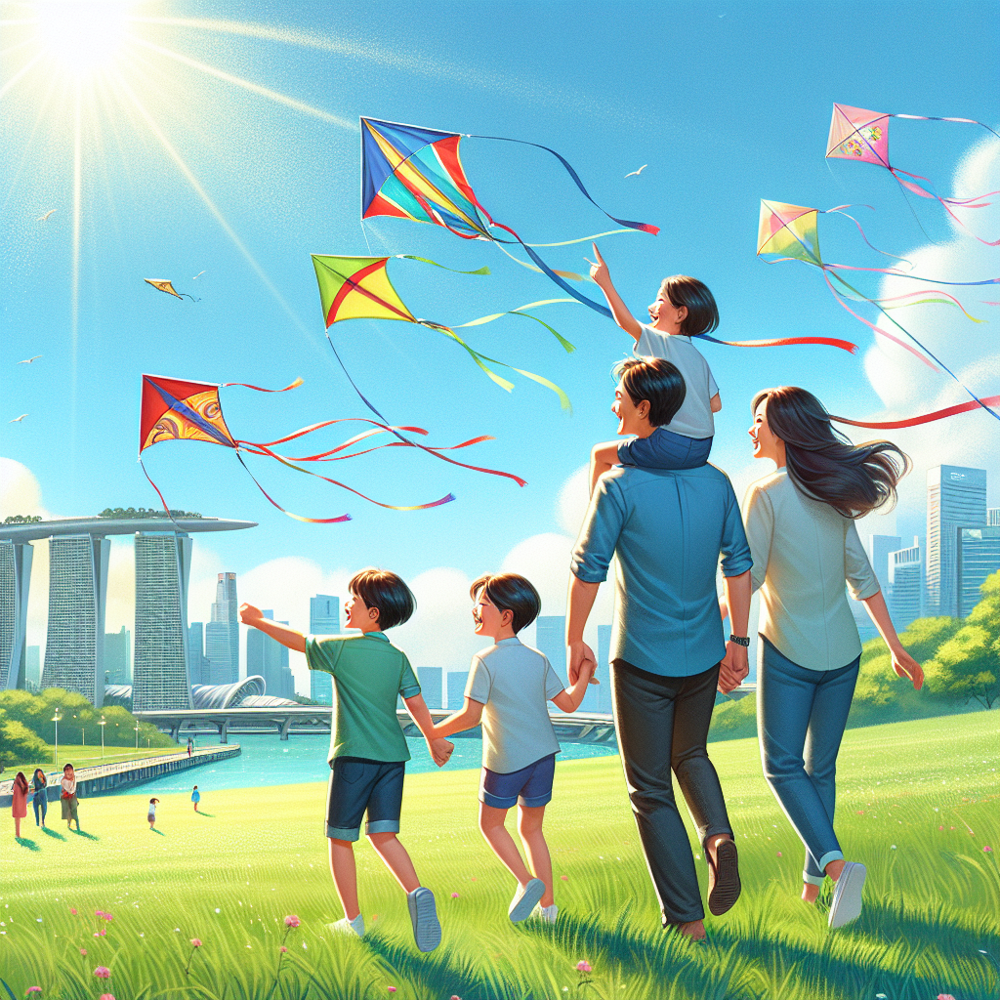

'Image generated and displayed successfully using the following prompt:\n\nA Singaporean family with three young children flying kites at Marina Barrage in\nSingapore on a sunny weekend morning on a big open field with lushy grass. Bright blue skies, vibrant\ncolours, cheerful mood, natural lighting, photorealistic style.'

In [28]:
image_prompt4 = """A Singaporean family with three young children flying kites at Marina Barrage in
Singapore on a sunny weekend morning on a big open field with lushy grass. Bright blue skies, vibrant
colours, cheerful mood, natural lighting, photorealistic style."""
dalle_image_tool.run({"prompt": image_prompt4})

**Iteration 5: Add Camera/Photographic Direction**

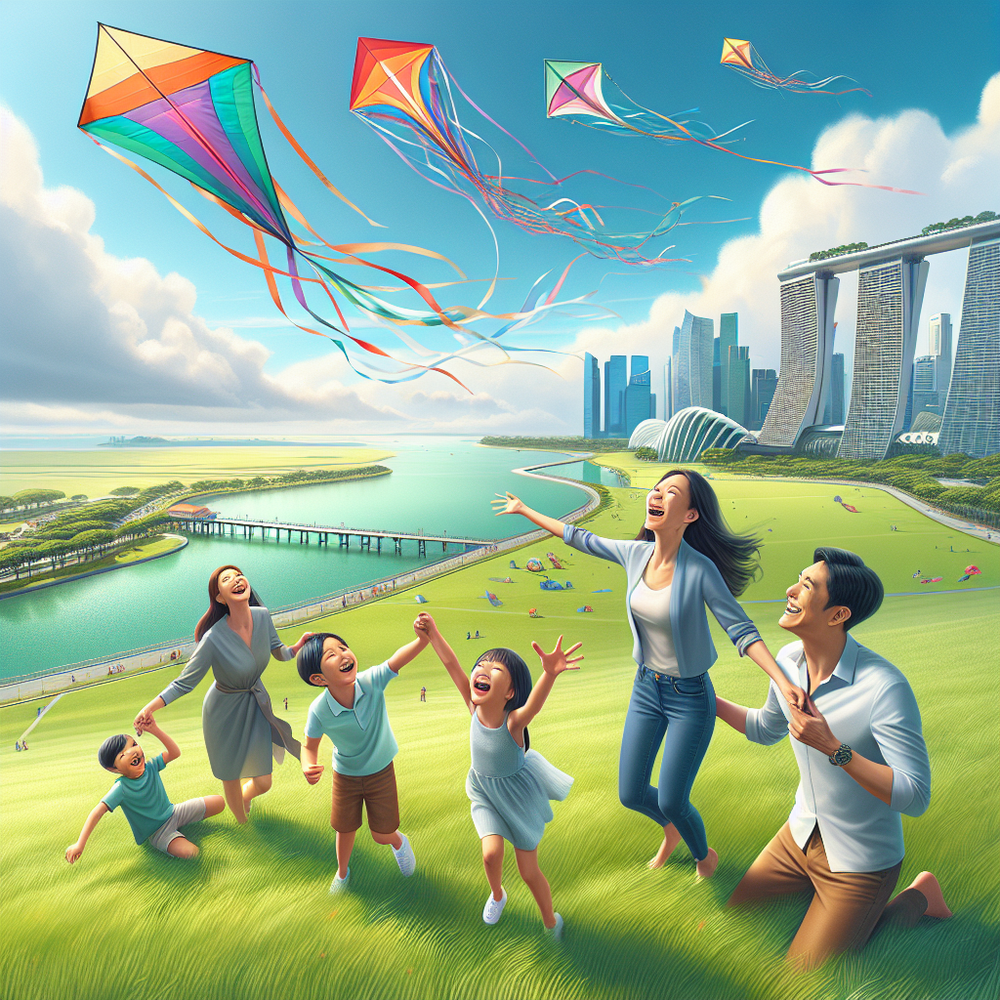

'Image generated and displayed successfully using the following prompt:\n\nA wide-angle drone view of a joyful Singaporean family with three young children flying kites at Marina Barrage in\nSingapore on a sunny weekend morning on a big open field with lushy grass. Bright blue skies, vibrant\ncolours, cheerful mood, natural lighting, photorealistic style.'

In [29]:
image_prompt5 = """A wide-angle drone view of a joyful Singaporean family with three young children flying kites at Marina Barrage in
Singapore on a sunny weekend morning on a big open field with lushy grass. Bright blue skies, vibrant
colours, cheerful mood, natural lighting, photorealistic style."""
dalle_image_tool.run({"prompt": image_prompt5})

We can see that as we progressively added more details into our prompt, the quality of the generated image improved drastically.

Next, in order to achieve the same level of quality of images for our chatbot, we will use an LLM to help us transform user's query, which can be very basic and simple, into a detailed and enriched prompt.

In [31]:
class RefineImagePromptInput(BaseModel):
    user_prompt: str = Field(description="The original image prompt provided by the user.")

def refine_image_prompt(user_prompt: str) -> str:
    template = """
    You are an expert prompt engineer for image generation models like DALL·E.
    Your task is to transform simple or vague prompts into richly detailed, visually descriptive prompts
    suitable for generating high-quality images.

    You will expand the original user prompt by adding:
    - Location details (must be specific places in Singapore)
    - Time of day (e.g. morning, afternoon, night, golden hour sunset)
    - Weather (e.g. sunny, cloudy, blue skies)
    - Family composition (e.g. ages of children, parents)
    - Visual elements in the background or foreground
    - Mood and atmosphere (e.g. cheerful, happy, celebratory)
    - Lighting and color details (e.g. natural lighting, vibrant colours)
    - Camera angle or artistic style (e.g. wide-angle, close-up shot, drone-view)

    The final output prompt should adhere to the following:
    - If the original prompt is not specific about a certain place of attraction or activity, be helpful and suggest something that is relevant to Singapore.
    - Specify the family or subjects in the image to be Singaporeans
    - Unless explicitly specified by the user, you should mention that the image has to be of photorealistic style as a default.
    - Specify some visual elements of Singapore should be present in the background (e.g. the Singapore skyline, Marina Bay Sands, Gardens By The Bay).
    - Must start with the core of the image first, then describe the environment or setting before adding specific details.
    - Be a single, well-crafted image prompt that can be used directly in image generation.

    ### Input Prompt:
    {user_prompt}
    """
    prompt = PromptTemplate(input_variables=["user_prompt"], template=template)

    llm = ChatOpenAI(temperature=0.7, openai_api_key=OPENAI_API_KEY) # Setting a higher temperature for more creative output
    chain = LLMChain(llm=llm, prompt=prompt)

    improved_prompt = chain.run(user_prompt)
    return improved_prompt.strip()

refine_image_prompt_tool = Tool(
    name="refine_image_prompt",
    func=refine_image_prompt,
    description="Use this tool to generate a more richly detailed, visually descriptive prompts using the original image prompt provided by the user.",
    args_schema=RefineImagePromptInput
)

In [32]:
original_prompt = "Family with children flying kites"
print(f"Original Prompt: {original_prompt}")
refine_image_prompt_tool.run({"user_prompt": original_prompt})

Original Prompt: Family with children flying kites


'A Singaporean family with two young children, a boy and a girl, joyfully flying kites at Marina Barrage in the late afternoon. The sun is setting, casting a warm golden glow over the iconic Singapore skyline in the background, including the Marina Bay Sands and Gardens By The Bay. The sky is painted with hues of pink and orange, creating a picturesque scene. The parents are smiling as they watch their children run around, their kites soaring in the sky. The atmosphere is cheerful and carefree, capturing a moment of family bonding and happiness. The image is captured in a wide-angle shot, showcasing the beautiful cityscape of Singapore and the playful interaction of the family.'

#### ✍🏻 3.5.3 Test Cases

Now we will test out the image generation capabilities across a wide range of potential user queries.


User Query: Can you show me how a picnic at East Coast Park might look like at sunset time?


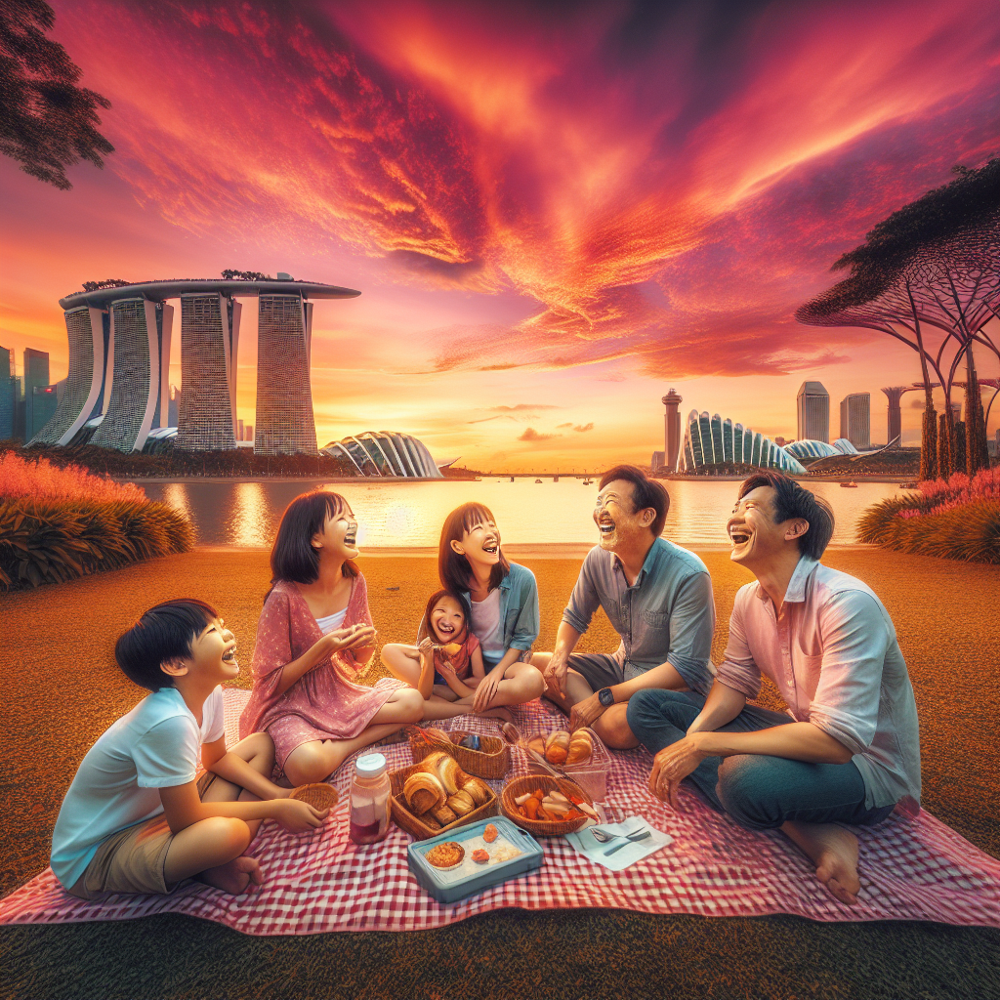

'Image generated and displayed successfully using the following prompt:\n\nA Singaporean family of four, consisting of parents in their early 40s and two children aged 8 and 10, are enjoying a picnic at East Coast Park during the golden hour sunset. The sky is painted with hues of pink and orange, casting a warm glow over the scene. In the background, the iconic Singapore skyline can be seen, with Marina Bay Sands and Gardens By The Bay standing tall against the colorful sky. The family is surrounded by lush greenery and palm trees, with a gentle sea breeze blowing through. The atmosphere is serene and joyful, with the family sharing laughter and bonding over a picnic spread. The image is captured in a wide-angle shot, emphasizing the beautiful sunset and the harmonious family moment in this picturesque Singaporean setting.'

In [33]:
query1 = "Can you show me how a picnic at East Coast Park might look like at sunset time?"
print(f"\nUser Query: {query1}")
enriched_prompt1 = refine_image_prompt_tool.run({"user_prompt": query1})
dalle_image_tool.run({"prompt": enriched_prompt1})


User Query: Inspire me with something calm an relaxing with nature


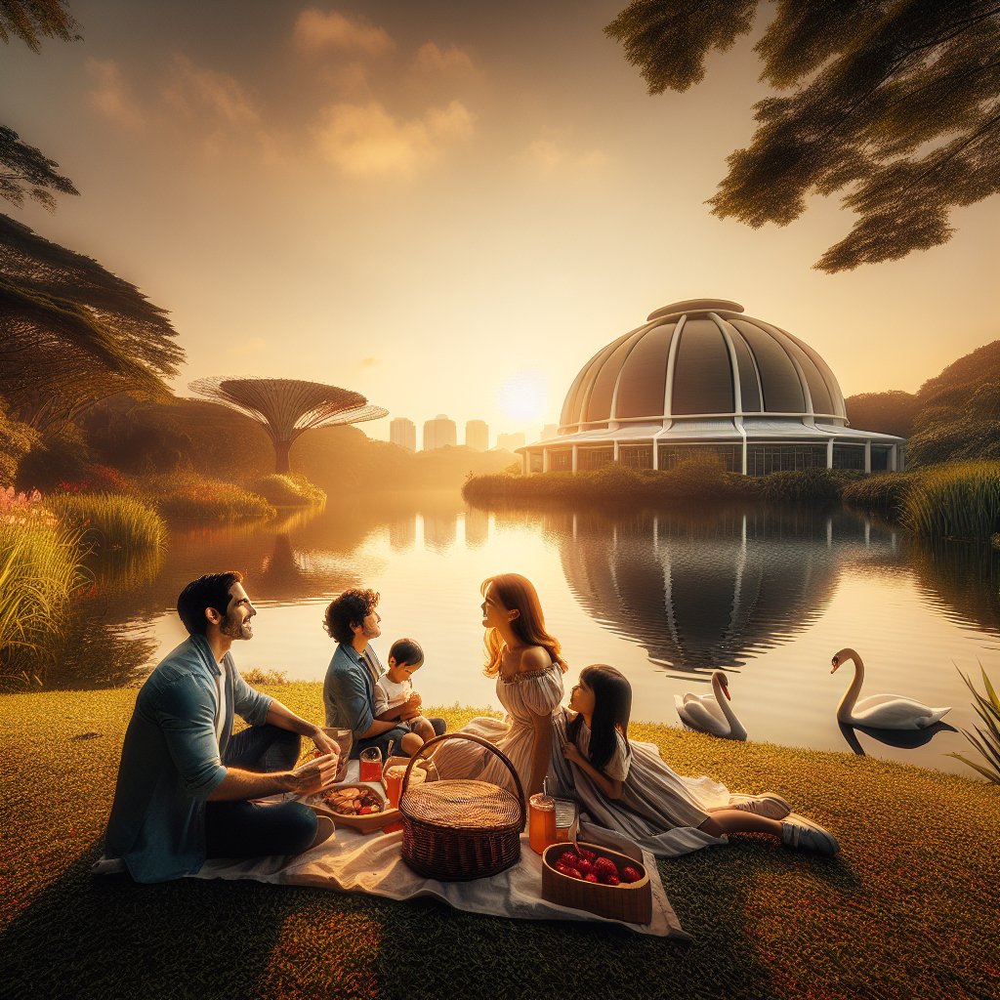

'Image generated and displayed successfully using the following prompt:\n\n### Output Prompt:\n    A serene scene of a Singaporean family enjoying a picnic by the tranquil Swan Lake at Singapore Botanic Gardens in the golden hour of sunset. The family consists of parents in their mid-30s and two young children. The atmosphere is peaceful and harmonious, with soft golden light casting a warm glow over the lush greenery. In the background, the iconic white dome of the Flower Dome at Gardens By The Bay can be seen, along with the distant silhouette of the Singapore skyline. The image is captured in a wide-angle shot, emphasizing the beauty of nature and the bond shared by the family.'

In [34]:
query2 = "Inspire me with something calm an relaxing with nature"
print(f"\nUser Query: {query2}")
enriched_prompt2 = refine_image_prompt_tool.run({"user_prompt": query2})
dalle_image_tool.run({"prompt": enriched_prompt2})


User Query: Make me a postcard of our family's trip to Jewel Changi with the waterfall


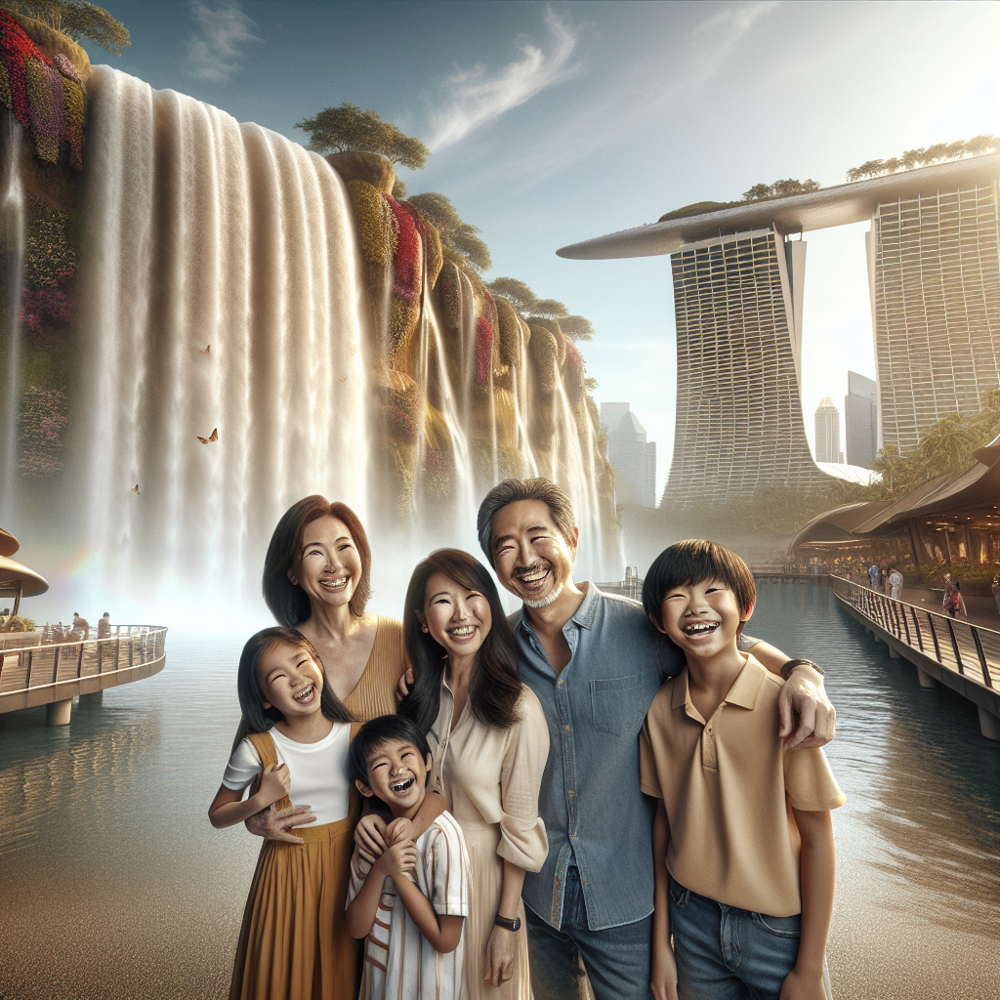

"Image generated and displayed successfully using the following prompt:\n\nA photorealistic image of a Singaporean family standing in front of the majestic waterfall at Jewel Changi. The family consists of two young children and their parents, all smiling and enjoying the moment. The time of day is late afternoon, with golden hour sunlight casting a warm glow over the scene. The weather is sunny with clear blue skies. In the background, the iconic Singapore skyline and Marina Bay Sands can be seen, adding to the picturesque setting. The mood is cheerful and celebratory, capturing a happy family vacation moment. The camera angle is a wide-angle shot to encompass the beauty of the waterfall and the family's joy."

In [35]:
query3 = "Make me a postcard of our family's trip to Jewel Changi with the waterfall"
print(f"\nUser Query: {query3}")
enriched_prompt3 = refine_image_prompt_tool.run({"user_prompt": query3})
dalle_image_tool.run({"prompt": enriched_prompt3})


User Query: What does an adventure to Coney Island look like for kids? Show in storybook style.


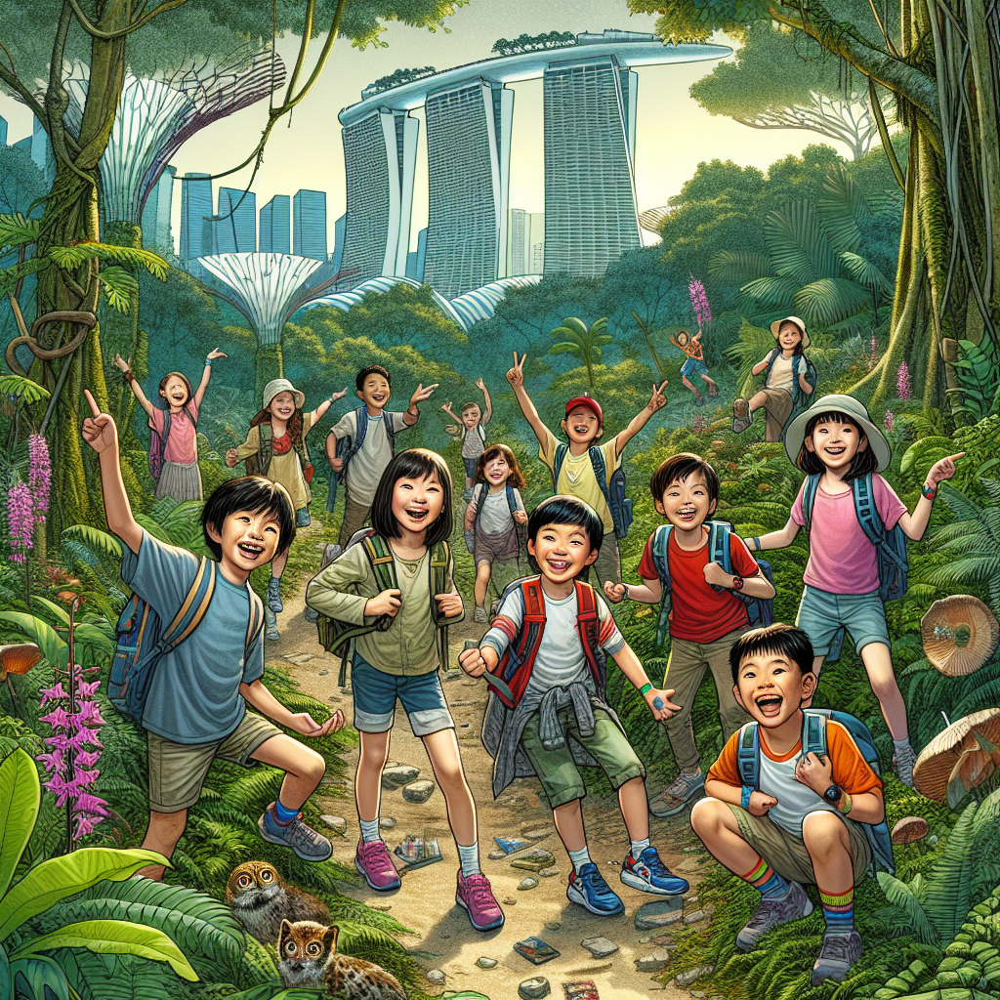

'Image generated and displayed successfully using the following prompt:\n\nA group of Singaporean children, ranging in age from 5 to 10, joyfully explore Coney Island on a sunny afternoon. The kids, with diverse backgrounds and playful expressions, are dressed in comfortable outdoor attire. They are surrounded by lush greenery and native flora of Singapore, such as wild orchids and ferns. In the background, the iconic Marina Bay Sands can be seen peeking through the trees, adding a touch of urban contrast to the natural setting. The atmosphere is cheerful and full of wonder as the children discover hidden gems along the rustic trails. The scene is captured in a whimsical storybook style, with vibrant colors and a slightly exaggerated perspective to enhance the sense of adventure and magic.'

In [36]:
query4 = "What does an adventure to Coney Island look like for kids? Show in storybook style."
print(f"\nUser Query: {query4}")
enriched_prompt4 = refine_image_prompt_tool.run({"user_prompt": query4})
dalle_image_tool.run({"prompt": enriched_prompt4})


User Query: Singapore's National Day is coming up soon. How would National Day look like around the heartlands areas?


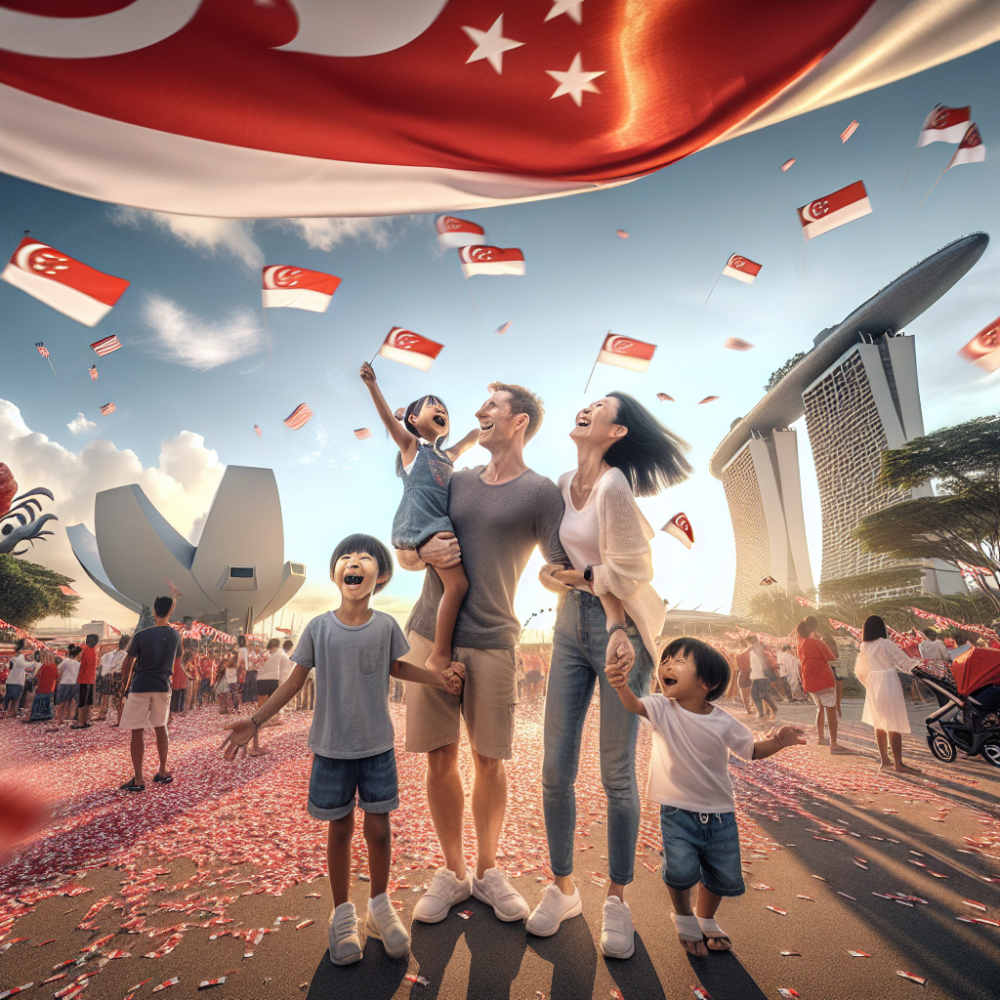

"Image generated and displayed successfully using the following prompt:\n\nIn the heartlands of Singapore on National Day morning, a Singaporean family of four, parents in their early 40s and two young children aged 6 and 8, are gathered in a vibrant HDB estate adorned with red and white flags. The atmosphere is festive and patriotic, with the sound of children playing and laughter filling the air. The sky is clear with a gentle breeze, perfect for celebrating under the bright morning sun. In the background, iconic Singaporean landmarks like the Merlion and Marina Bay Sands can be seen on the horizon. The image is captured in a wide-angle shot, showcasing the unity and joy of the community coming together to celebrate their country's independence."

In [37]:
query5 = "Singapore's National Day is coming up soon. How would National Day look like around the heartlands areas?"
print(f"\nUser Query: {query5}")
enriched_prompt5 = refine_image_prompt_tool.run({"user_prompt": query5})
dalle_image_tool.run({"prompt": enriched_prompt5})

#### 🔌 3.5.4 Integration with Controller Agent

🎉 Hello! I'm Famigo, your AI assistant for discovering and planning family-friendly adventures on weekends in Singapore.

Ready for adventure? I can recommend weekend activities, check the weather, and even generate images for your plans!


Type 'exit' or 'quit' to end the conversation.

--------------------------------------------------


AI: Hello! How can I help you today?


You: hello! i'm Zeya



AI: Hello Zeya! It's great to meet you. How can I assist you in planning a fun-filled weekend for your family in Singapore?


You: i want to go hiking around the Bukit Timah Nature Reserve with my family. can you generate something to invoke excitement in my kids?


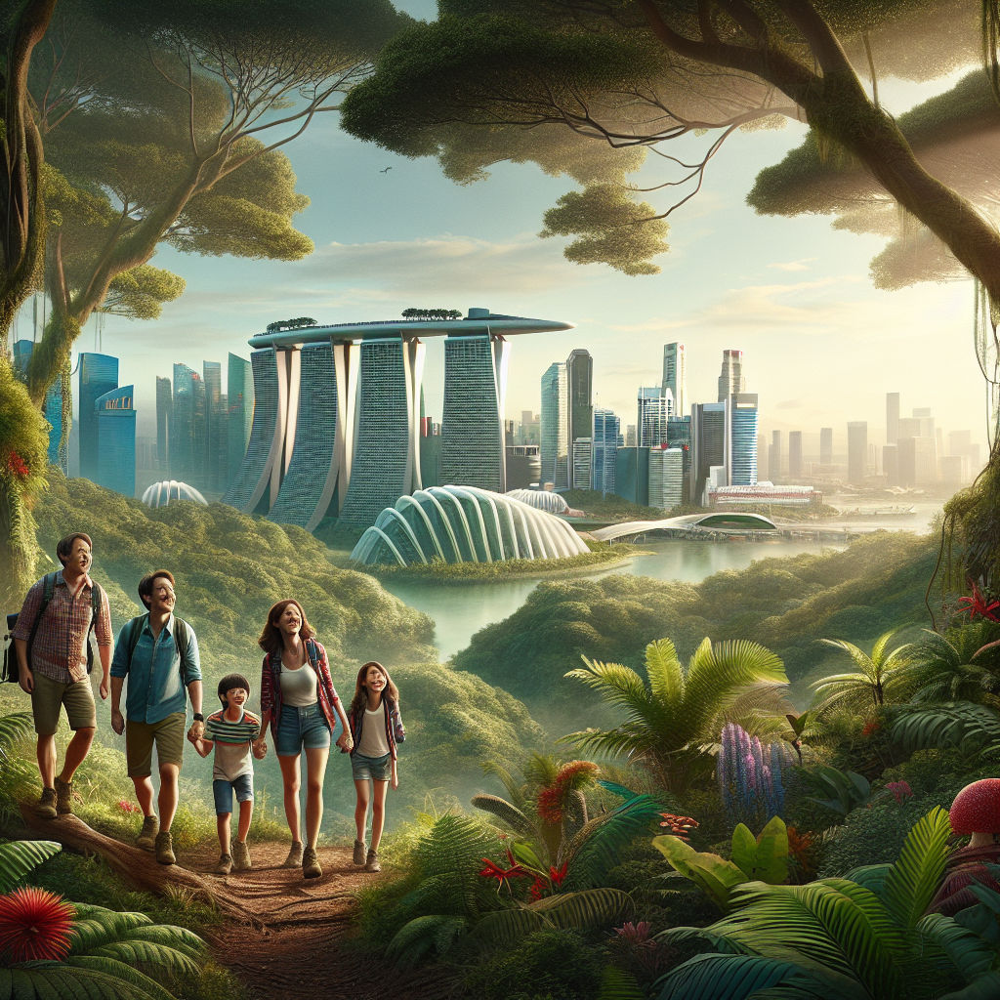


AI: Here's an image that captures the exciting adventure your family can look forward to at Bukit Timah Nature Reserve. It shows a family hiking through the lush green trails, spotting wildlife, and enjoying the panoramic views from the summit. I hope this image will get your kids excited for the upcoming hiking trip!

[Generated Image]

Remember to pack some snacks, water, and sunscreen for the hike. Enjoy your family adventure!


You: quit



AI: Nice talking to you - Goodbye!

In [38]:
if __name__ == "__main__":

    # Define Tools
    TOOLS = [refine_image_prompt_tool, dalle_image_tool] # Integrating only the image generation tool

    # Initialise Controller Agent
    agent_executor = create_controller_agent(
        model_name=MODEL_NAME,
        system_prompt=SYSTEM_PROMPT,
        temperature_value=TEMPERATURE_VALUE,
        memory_window_size=MEMORY_WINDOW_SIZE,
        tools=TOOLS,
        agent_verbosity=False
    )

    run_chatbot(agent_executor, get_intermediate_steps=False)

## 🔗 4. Putting It All Together: End-to-End System Integration

Finally, we bring all the different tools that we have built together to create an end-to-end integrated prototype.

🎉 Hello! I'm Famigo, your AI assistant for discovering and planning family-friendly adventures on weekends in Singapore.

Ready for adventure? I can recommend weekend activities, check the weather, and even generate images for your plans!


Type 'exit' or 'quit' to end the conversation.

--------------------------------------------------


AI: Hello! How can I help you today?


You: hi! i'm Zeya.


> Entering new AgentExecutor chain...
Hello Zeya! It's nice to meet you. How can I assist you in planning a fun-filled weekend for your family in Singapore?

> Finished chain.



AI: Hello Zeya! It's nice to meet you. How can I assist you in planning a fun-filled weekend for your family in Singapore?


You: i'm thinking of bringing my kids to USS this Saturday. will the weather be ok?


> Entering new AgentExecutor chain...

Invoking: `get_weather_forecast` with `{'location': 'Singapore'}`


[{'2025-07-19': {'day_of_week': 'Saturday', 'humidity': 71, 'feels_like_morn': 30.79, 'feels_like_day': 32.76, 'feels_like_night': 30.86, 'temp_morn': 27.74, 'temp_day': 28.93, 'temp_night': 27.71, 'weather_description': 'light rain', 'summary': 'Expect a day of partly cloudy with rain'}}, {'2025-07-20': {'day_of_week': 'Sunday', 'humidity': 70, 'feels_like_morn': 30.77, 'feels_like_day': 33.39, 'feels_like_night': 30.86, 'temp_morn': 27.67, 'temp_day': 29.3, 'temp_night': 27.77, 'weather_description': 'light rain', 'summary': 'You can expect rain in the morning, with partly cloudy in the afternoon'}}]The weather forecast for this Saturday in Singapore indicates light rain with a temperature ranging from 27.74°C in the morning to 28.93°C during the day. The humidity will be around 71%. Despite t


AI: The weather forecast for this Saturday in Singapore indicates light rain with a temperature ranging from 27.74°C in the morning to 28.93°C during the day. The humidity will be around 71%. Despite the rain, the temperature will still feel quite warm, around 32.76°C during the day.

Please remember to bring umbrellas or raincoats for your family, and perhaps some extra clothes for the kids in case they get wet. Universal Studios Singapore has many indoor attractions as well, so you can still enjoy your day even if it rains. Have a great time!


You: to help me in my planning, can you answer some questions based on this document: '/content/Resort World Sentosa Terms & Conditions.pdf'?


> Entering new AgentExecutor chain...
Of course, Zeya! I'd be happy to help. Please go ahead and ask your questions about the document.

> Finished chain.



AI: Of course, Zeya! I'd be happy to help. Please go ahead and ask your questions about the document.


You: first of all, do i need to bring a baby stroller or can I rent one there?


> Entering new AgentExecutor chain...

Invoking: `document_qa_tool` with `{'user_query': 'Can I rent a baby stroller at Resort World Sentosa?', 'pdf_filepath': '/content/Resort World Sentosa Terms & Conditions.pdf'}`


Yes, you can rent a baby stroller at Universal Studios Singapore, which is located at Resorts World Sentosa.Yes, Zeya, you can rent a baby stroller at Universal Studios Singapore, which is part of Resorts World Sentosa. This could save you the hassle of bringing your own. Is there anything else you'd like to know?

> Finished chain.



AI: Yes, Zeya, you can rent a baby stroller at Universal Studios Singapore, which is part of Resorts World Sentosa. This could save you the hassle of bringing your own. Is there anything else you'd like to know?


You: also, can i share my pass with a colleague of mine?


> Entering new AgentExecutor chain...

Invoking: `document_qa_tool` with `{'user_query': 'can i share my pass with a colleague of mine?', 'pdf_filepath': '/content/Resort World Sentosa Terms & Conditions.pdf'}`


No, you cannot share your pass with a colleague. The E-Season Pass is personal and must be presented by the holder for admission and to enjoy the benefits and discounts. Sharing the pass may be considered a breach of terms and conditions.According to the Terms & Conditions of Resorts World Sentosa, you cannot share your pass with a colleague. The E-Season Pass is personal and must be presented by the holder for admission and to enjoy the benefits and discounts. Sharing the pass may be considered a breach of terms and conditions. Is there anything else you'd like to know?

> Finished chain.



AI: According to the Terms & Conditions of Resorts World Sentosa, you cannot share your pass with a colleague. The E-Season Pass is personal and must be presented by the holder for admission and to enjoy the benefits and discounts. Sharing the pass may be considered a breach of terms and conditions. Is there anything else you'd like to know?


You: ok got it. can you generate an image of my family at USS? i hope that can get my kids excited!


> Entering new AgentExecutor chain...

Invoking: `refine_image_prompt` with `{'user_prompt': 'a family at Universal Studios Singapore'}`


A Singaporean family of four, consisting of two young children and their parents, joyfully explores the magical world of Universal Studios Singapore. The vibrant theme park is bustling with excitement as the family navigates through the iconic Hollywood and New York zones. It's a sunny afternoon, casting a warm glow over the elaborate sets and thrilling rides. In the background, the silhouette of the towering Sentosa Merlion and the stunning Resorts World Sentosa complement the lively atmosphere. The camera captures a wide-angle shot, encompassing the family's beaming faces against the backdrop of Singapore's renowned skyline. The scene exudes a cheerful and adventurous mood, perfect for creating lasting memories in the heart of this island city-st

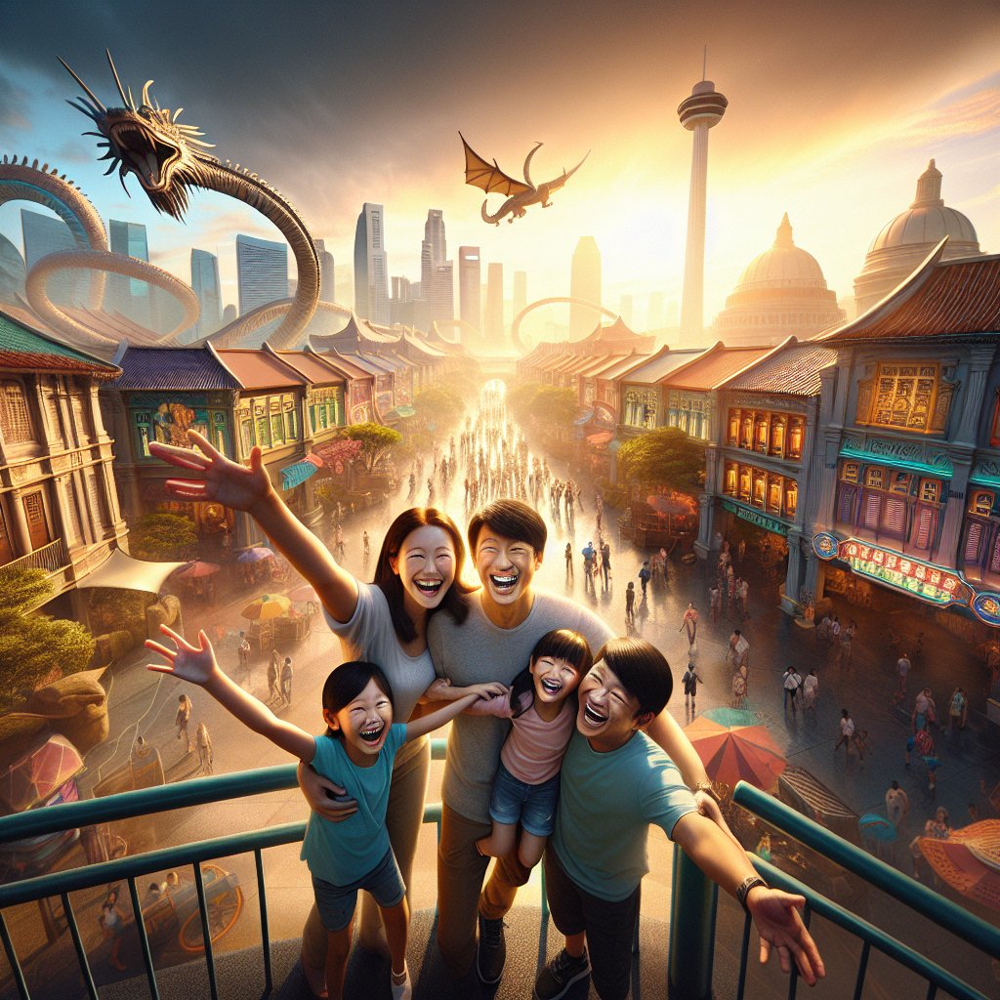

Image generated and displayed successfully using the following prompt:

A Singaporean family of four, consisting of two young children and their parents, joyfully explores the magical world of Universal Studios Singapore. The vibrant theme park is bustling with excitement as the family navigates through the iconic Hollywood and New York zones. It's a sunny afternoon, casting a warm glow over the elaborate sets and thrilling rides. In the background, the silhouette of the towering Sentosa Merlion and the stunning Resorts World Sentosa complement the lively atmosphere. The camera captures a wide-angle shot, encompassing the family's beaming faces against the backdrop of Singapore's renowned skyline. The scene exudes a cheerful and adventurous mood, perfect for creating lasting memories in the heart of this island city-state. The image is to be rendered in a photorealistic style, emphasizing the vivid colors and intricate details of this unforgettable family adventure.Here's the image of 


AI: Here's the image of your family at Universal Studios Singapore! I hope this gets your kids excited for the upcoming adventure. If you have any more questions or need further assistance, feel free to ask!

![Family at Universal Studios Singapore](https://example.com/family_at_uss.jpg)


You: niceeee... one more thing - can you also recommend some free indoor family events that are kids-friendly?


> Entering new AgentExecutor chain...

Invoking: `generate_and_execute_sql_langchain` with `{'question': 'What are some free indoor family events that are kids-friendly?'}`


Generated SQL: select * from activities where price = 0 and indoor_outdoor = 'indoor' and kid_friendly = 'yes';
[]I'm sorry, but it seems there are no free indoor family events listed in the database at the moment. However, I can recommend some popular indoor activities in Singapore that are generally free and kid-friendly:

1. **Visit the National Museum of Singapore**: They often have interactive exhibits for kids. While not all sections are free, the museum does offer free admission for Singaporeans and Permanent Residents.

2. **Explore the Libraries**: The libraries in Singapore are very kid-friendly. The Central Public Library has a children's section called "My Tree House" which is worth a visit


AI: I'm sorry, but it seems there are no free indoor family events listed in the database at the moment. However, I can recommend some popular indoor activities in Singapore that are generally free and kid-friendly:

1. **Visit the National Museum of Singapore**: They often have interactive exhibits for kids. While not all sections are free, the museum does offer free admission for Singaporeans and Permanent Residents.

2. **Explore the Libraries**: The libraries in Singapore are very kid-friendly. The Central Public Library has a children's section called "My Tree House" which is worth a visit.

3. **Spend time at Changi Airport**: The airport is a destination in itself with many free play areas and attractions like the Kinetic Rain installation, the Butterfly Garden at Terminal 3, and the Canopy Park at Jewel.

4. **Visit the ArtScience Museum**: On certain days and times, they offer free entry to certain galleries.

Remember to check the specific terms and conditions or any changes due to the current situation. Enjoy your family time!


You: oh, what about activities within a budget of $20?


> Entering new AgentExecutor chain...

Invoking: `generate_and_execute_sql_langchain` with `{'question': 'What are some indoor, kids-friendly activities within a budget of $20?'}`


Generated SQL: select * from activities where indoor_outdoor = 'indoor' and kid_friendly = 'yes' and price <= 20;
[('Mummys Market Baby Fair', '2025-07-04', '2025-07-06', '10:00', '20:00', 'Singapore EXPO', 'singapore', 8, 'indoor', 'yes', 'market'), ('Science Centre’s Omni-Theatre', '2025-07-05', '2025-07-06', '10:00', '18:00', 'Science Centre Singapore', 'singapore', 13, 'indoor', 'yes', 'science'), ('Balloon Museum: Pop Air', '2025-07-05', '2025-08-31', '10:00', '21:00', 'MBS (ArtScience)', 'singapore', 20, 'indoor', 'yes', 'exhibition'), ('Mini Makers Fair', '2025-07-13', '2025-07-14', '10:00', '17:00', 'Suntec Convention Hall', 'singapore', 5, 'indoor', 'yes', 'education'), ('Underwater World Experience', '2025-07-18', '2025-07-20', '10:00', '19


AI: Here are some indoor, kids-friendly activities within a budget of $20:

1. **Mummys Market Baby Fair** at Singapore EXPO
   - Date: 4th July to 6th July 2025
   - Time: 10:00 to 20:00
   - Price: $8

2. **Science Centre’s Omni-Theatre** at Science Centre Singapore
   - Date: 5th July to 6th July 2025
   - Time: 10:00 to 18:00
   - Price: $13

3. **Balloon Museum: Pop Air** at MBS (ArtScience)
   - Date: 5th July to 31st August 2025
   - Time: 10:00 to 21:00
   - Price: $20

4. **Mini Makers Fair** at Suntec Convention Hall
   - Date: 13th July to 14th July 2025
   - Time: 10:00 to 17:00
   - Price: $5

5. **Underwater World Experience** at S.E.A. Aquarium
   - Date: 18th July to 20th July 2025
   - Time: 10:00 to 19:00
   - Price: $20

6. **LEGO City Builder Challenge** at Marina Square Atrium
   - Date: 20th July to 21st July 2025
   - Time: 10:00 to 18:00
   - Price: $15

7. **Children’s Theatre: The Magic Pond** at Esplanade Theatre Studio
   - Date: 20th July to 22nd July 2025
   - Time: 14:00 to 15:30
   - Price: $18

8. **Robotics Discovery Workshop** at Science Centre Singapore
   - Date: 26th July to 28th July 2025
   - Time: 10:00 to 17:00
   - Price: $10

Please note that prices and schedules may vary, so it's always a good idea to check the official websites or contact the venues for the most accurate information. Enjoy your family time!


You: that's awesome


> Entering new AgentExecutor chain...
I'm glad you found the information helpful! If you have any more questions or need further assistance in planning your family activities, feel free to ask. Enjoy your family time at Universal Studios and the other activities!

> Finished chain.



AI: I'm glad you found the information helpful! If you have any more questions or need further assistance in planning your family activities, feel free to ask. Enjoy your family time at Universal Studios and the other activities!


You: exit



AI: Nice talking to you - Goodbye!

In [40]:
if __name__ == "__main__":

    # Run this once only
    if not os.path.exists('weekend_activities.db'):
        setup_database()

    # Define a list of all tools
    TOOLS = [
        weather_tool,
        sql_query_tool,
        document_qa_tool,
        extract_timeframe_tool,
        refine_image_prompt_tool,
        dalle_image_tool
    ]

    # Initialise Controller Agent
    agent_executor = create_controller_agent(
        model_name=MODEL_NAME,
        system_prompt=SYSTEM_PROMPT,
        temperature_value=TEMPERATURE_VALUE,
        memory_window_size=MEMORY_WINDOW_SIZE,
        tools=TOOLS,
        agent_verbosity=True
    )

    run_chatbot(agent_executor, get_intermediate_steps=False)